In [7]:
import csv
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer

In [8]:
df1 = pd.read_csv('/Users/shiruizhou/Desktop/DS3/final project _ chords + lyrics /raw data/three_four_five_has_audio_pruned.csv')
print(df1.shape)
df1.sample(5, random_state=123)

(12511, 20)


,cp,artist,song,section,spotify_ID,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cp_length,genres
6659,"4,5,1,4,1",the beatles,please please me,verse,6EHuOufBeL6vk3TvVJB5qo,0.527,0.480,4.0,-9.610,1.0,0.0280,0.334,0.000000,0.0702,0.706,139.388,120853.0,4.0,5,"['british invasion', 'merseybeat', 'psychedeli..."
1855,"4,1,4,6",aqualung,brighter than sunshine,chorus,3W6UA36h0zahjxU709wLSI,0.314,0.483,11.0,-8.365,1.0,0.0351,0.229,0.026900,0.5640,0.348,145.047,241360.0,4.0,4,['piano rock']
9587,"6,2,6,2,6",queen,another one bites the dust,chorus,57JVGBtBLCfHw2muk5416J,0.951,0.530,5.0,-6.594,0.0,0.1780,0.115,0.179000,0.1700,0.699,109.979,214653.0,4.0,5,"['glam rock', 'rock']"
9872,"6,3,6,3,4",sistar,alone,chorus,40gUfKHwCNLpXowFN9Hvsu,0.762,0.961,4.0,-2.330,0.0,0.0368,0.293,0.000000,0.1360,0.885,114.979,206315.0,4.0,5,"['dance pop', 'k-pop', 'korean pop']"
7963,"6,4,5,6,1",madonna,material girl,chorus,22sLuJYcvZOSoLLRYev1s5,0.742,0.883,0.0,-3.419,1.0,0.0329,0.333,0.000008,0.0964,0.978,136.506,240280.0,4.0,5,"['dance pop', 'pop', 'pop rock']"


In [9]:
df2 = pd.read_csv('/Users/shiruizhou/Desktop/DS3/final project _ chords + lyrics /raw data/spotify_millsongdata.csv')
print(df2.shape)
df2['song'] = df2['song'].str.lower()
df2['artist'] = df2['artist'].str.lower()
df2.sample(5, random_state=123)

(57650, 4)


,artist,song,link,text
27648,chris rea,stop,/c/chris+rea/stop_20030669.html,Gone too far \r\nGone too long \r\nMessed it...
33527,george harrison,absolutely sweet marie,/g/george+harrison/absolutely+sweet+marie_2005...,"Well, your railroad gate, you know I just can'..."
14391,nofx,hobophobic,/n/nofx/hobophobic_20101516.html,Hobo - I'm hobophobic So what ah ah ah \r\nSc...
9211,jason mraz,so unusual,/j/jason+mraz/so+unusual_20574015.html,This is the most unusual story \r\nOf a most ...
26456,britney spears,girl in the mirror,/b/britney+spears/girl+in+the+mirror_20024648....,There's a girl in the mirror \r\nI wonder who...


In [10]:
common_rows = pd.merge(df1, df2, on=['song', 'artist'])
print(common_rows.shape)


(2673, 22)


In [11]:
# Convert 'text' column to dictionary
text_dict = common_rows['text'].to_dict()

In [12]:
num_common_rows = len(common_rows)
print(f"Number of common rows: {num_common_rows}")

Number of common rows: 2673


Identifying specific sections of a song (like chorus, verse, pre-chorus, etc.) based solely on the textual content of the lyrics is challenging. Generally, the identification of these sections is more straightforward when analyzing the musical composition and structure of a song rather than just the lyrics. However, some general observations can be made:

1. **Repetition**: The chorus is typically the most repetitive part of a song, both in terms of lyrics and musical composition. In the text you've provided, the lines "I was cryin' when I met you" and variations thereof seem to be repeated multiple times, suggesting it might be the chorus.

2. **Structure**: Songs often follow a structure like "verse-chorus-verse-chorus-bridge-chorus." You can look for patterns in the lyrics to identify different sections.

3. **Content**: Verses often tell a story or provide context, while choruses usually convey the main message or emotion of the song. Bridges might offer a different perspective or a twist in the narrative.

Given the text you provided, we can make some educated guesses:

- The lines from "There was a time" to "By the way I got kissed" might be an intro and a verse.
- The lines starting with "I was cryin' when I met you" that follow seem to be the chorus, given the repetition observed.
- "Now there's not even breathing room" to "That's a fire I can't resist" might constitute another verse.
- There are multiple repetitions of the lines that seem to form the chorus, followed by variations.
- The lines "Cause what you got inside" to "'Til you give your heart away" might form a bridge.

However, these are only educated guesses based on textual patterns. To truly identify the different sections of a song, you'd need to listen to the music and analyze it in conjunction with the lyrics.

In [13]:
import re
from collections import Counter

def identify_sections(lyrics):
    # Split the lyrics into lines
    lines = lyrics.split('\n')

    # Remove empty lines and whitespace
    lines = [line.strip() for line in lines if line.strip()]

    # Count the frequency of each line
    line_counts = Counter(lines)

    # Identify chorus lines based on repetition
    chorus_lines = {line for line, count in line_counts.items() if count > 1}

    # Print chorus lines
    print("Chorus:")
    for line in chorus_lines:
        print(line)

    # Identify verse and bridge based on position
    verse_lines = set()
    bridge_lines = set()
    for i, line in enumerate(lines):
        if line not in chorus_lines:
            if i < len(lines) - 1 and lines[i + 1] in chorus_lines:
                bridge_lines.add(line)
            else:
                verse_lines.add(line)

    # Print verse lines
    print("\nVerse:")
    for line in verse_lines:
        print(line)

    # Print bridge lines
    print("\nBridge:")
    for line in bridge_lines:
        print(line)



In [14]:
lyrics = "There was a time  \r\nWhen I was so brokenhearted  \r\nLove wasn't much of a friend of mine  \r\nThe tables have turned - yeah  \r\n'Cause me and them ways have parted  \r\nThat kinda love was the killin' kind  \r\nAll I want is someone I can't resist  \r\nI know - all I - need to know  \r\nBy the way I got kissed  \r\nI was cryin' when I met you  \r\nNow I'm tryin' to forget you  \r\nYour love is sweet misery  \r\nI was cryin' just to get you  \r\nNow I'm dryin' 'cause I let you  \r\nDo what you do down on me  \r\nNow there's not even breathing room  \r\nBetween pleasure and pain  \r\nYeah you cry when we're makin' love  \r\nMust be one and the same  \r\nIt's down on me  \r\nYeah, I got to tell you one thing  \r\nIt's been on my mind, girl I gotta say  \r\nWe're partners in crime  \r\nYou got that certain something  \r\nWhat you do to me takes my breath away  \r\nNow the word out on the street  \r\nIs the devil's in your kiss  \r\nIf our love goes up in flames  \r\nThat's a fire I can't resist  \r\nI was cryin' when I met you  \r\nNow I'm tryin' to forget you  \r\nYour love is sweet misery  \r\nI was cryin' just to get you  \r\nNow I'm dyin' 'cause I let you  \r\nDo what you do to me  \r\n'Cause what you got inside  \r\nAin't where your love should stay  \r\nYeah, our love, sweet love, ain't love  \r\n'Til you give your heart away  \r\nI was cryin' when I met you  \r\nNow I'm tryin' to forget you  \r\nYour love is sweet misery  \r\nI was cryin' just to get you  \r\nNow I'm dyin' just to let you  \r\nDo what you do, what you do down on me  \r\nBaby, baby, baby  \r\nI was cryin' when I met you  \r\nNow I'm tryin' to forget you  \r\nYour love is sweet misery  \r\nI was cryin' when I met you  \r\nNow I'm dyin' 'cause I let you  \r\nDo what you do down to, down to, down to  \r\nI was cryin' when I met you  \r\nNow I'm tryin' to forget you  \r\nYour love is sweet misery\r\n\r\n"

identify_sections(lyrics )

Chorus:
I was cryin' when I met you
I was cryin' just to get you
Now I'm dyin' 'cause I let you
Your love is sweet misery
Now I'm tryin' to forget you

Verse:
Yeah, our love, sweet love, ain't love
If our love goes up in flames
Now I'm dyin' just to let you
It's down on me
Now the word out on the street
'Cause what you got inside
Is the devil's in your kiss
Do what you do, what you do down on me
What you do to me takes my breath away
'Cause me and them ways have parted
Now there's not even breathing room
Yeah you cry when we're makin' love
Must be one and the same
There was a time
It's been on my mind, girl I gotta say
That kinda love was the killin' kind
All I want is someone I can't resist
The tables have turned - yeah
Now I'm dryin' 'cause I let you
Do what you do down on me
Between pleasure and pain
I know - all I - need to know
We're partners in crime
Yeah, I got to tell you one thing
When I was so brokenhearted
Ain't where your love should stay
Love wasn't much of a friend of min

In [15]:
import pandas as pd
from collections import Counter

def identify_sections(lyrics):
    lines = lyrics.split('\n')
    lines = [line.strip() for line in lines if line.strip()]
    line_counts = Counter(lines)

    chorus_lines = [line for line, count in line_counts.items() if count > 1]
    verse_lines = [line for line in lines if line not in chorus_lines]

    chorus = '\n'.join(chorus_lines)
    verse = '\n'.join(verse_lines)

    return pd.Series([chorus, verse], index=['chorus', 'verse'])

# Apply the function to each row in 'text' column
common_rows[['chorus', 'verse']] = common_rows['text'].apply(identify_sections)


In [16]:
# Assuming you have a column 'section' in your DataFrame
common_rows['text_1'] = common_rows.apply(
    lambda row: row['verse'] if row['section'] == 'verse' else (
        row['chorus'] if row['section'] in ['chorus', 'pre-chorus'] else None
    ),
    axis=1
)

In [17]:
common_rows['text_1']

0       There was a time\nWhen I was so brokenhearted\...
1       I was cryin' when I met you\nNow I'm tryin' to...
2       There was a time\nWhen I was so brokenhearted\...
3       There was a time\nWhen I was so brokenhearted\...
4       You just gotta ignite the light\nAnd let it sh...
                              ...                        
2668    Ha ha ha ha ha ha ha ha ha ha ha ha\nAura-a-a-...
2669    Jojo was a man who thought he was a loner\nBut...
2670    We can get down like there's no one around\nWe...
2671    Sorry, I cannot hear you\nI'm kinda busy\nK-ki...
2672    So, so you think you can tell\nHeaven from Hel...
Name: text_1, Length: 2673, dtype: object

In [18]:
# Drop missing or None values and then generate the frequency table
non_empty_count = common_rows['text_1'].notna().sum()
print(non_empty_count)


1848


In [19]:
common_rows['text_2'] = common_rows.apply(
    lambda row: row['chorus'] if row['section'] in ['chorus', 'pre-chorus', 'pre-chorus and chorus', 'bridge', 'outro', 'chorus lead-out', 'pre-outro', 'outro 1', 'outro 2'] else (
        row['verse'] if row['section'] in ['verse', 'intro', 'verse and pre-chorus', 'intro and verse', 'solo', 'solo 1'] else None
    ),
    axis=1
)

In [20]:
# Drop missing or None values and then generate the frequency table
non_empty_count = common_rows['text_2'].notna().sum()
print(non_empty_count)

2657


In [21]:
common_rows = common_rows[common_rows['text_2'].notna() & (common_rows['text_2'] != "")]
common_rows.shape

(2616, 26)

In [22]:
# Drop duplicates based on the columns ['song', 'artist', 'cp', 'section'] and keep the first occurrence
common_rows_unique = common_rows.drop_duplicates(subset=['song', 'artist', 'cp', 'section'], keep='first')

# Find repeated observations before dropping (for verification purpose)
duplicates = common_rows[common_rows.duplicated(subset=['song', 'artist', 'cp', 'section'], keep=False)]

# Display the repeated observations
# print(duplicates)

# If you want to replace common_rows with the unique version, uncomment the next line
common_rows = common_rows_unique
common_rows.shape

(2608, 26)

In [23]:
num_unique_songs = common_rows['song'].nunique()
print(num_unique_songs)


617


In [24]:
section_counts = common_rows['section'].value_counts()
print(section_counts)

section
chorus                   1035
verse                     648
intro                     210
verse and pre-chorus      141
pre-chorus                126
bridge                    125
intro and verse           114
pre-chorus and chorus     104
solo                       35
outro                      32
chorus lead-out            18
pre-outro                   9
solo 1                      5
outro 1                     4
outro 2                     2
Name: count, dtype: int64


intro, verse — chorus — verse — chorus —bridge — chorus — outro.

- chorus                   1127 - ['text_1'] = chorus
- verse                     692 - ['text_1'] = verse
- intro                     214 - ['text_1'] = verse
- verse and pre-chorus      150 - ['text_1'] = verse
- bridge                    134 - ['text_1'] = chorus
- pre-chorus                130 - ['text_1'] = chorus
- pre-chorus and chorus     118 - ['text_1'] = chorus
- intro and verse           117 - ['text_1'] = verse 
- solo                       35 - ['text_1'] = verse
- outro                      34 - ['text_1'] = chorus
- chorus lead-out            20 - ['text_1'] = chorus
- instrumental               18 - ['text_1'] = n.a.
- pre-outro                   9 - ['text_1'] = chorus 
- solo 1                      5 - ['text_1'] = verse
- outro 1                     4 - ['text_1'] = chorus 
- outro 2                     2 - ['text_1'] = chorus 


In [25]:
import ast

In [26]:
common_rows['genres'].fillna("[]", inplace=True)

# Convert string to list
common_rows['genres'] = common_rows['genres'].apply(ast.literal_eval)

# Define function to get main genre
def main_genre(genres):
    if genres is None or not genres:
        return 'Unknown'
    else:
        return genres[0]

# Apply function to create new column
common_rows['type'] = common_rows['genres'].apply(main_genre)

In [27]:
common_rows.to_csv('dataset.csv', index=False)
common_rows.columns

Index(['cp', 'artist', 'song', 'section', 'spotify_ID', 'danceability',
       'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms',
       'time_signature', 'cp_length', 'genres', 'link', 'text', 'chorus',
       'verse', 'text_1', 'text_2', 'type'],
      dtype='object')

## Feature exploration 

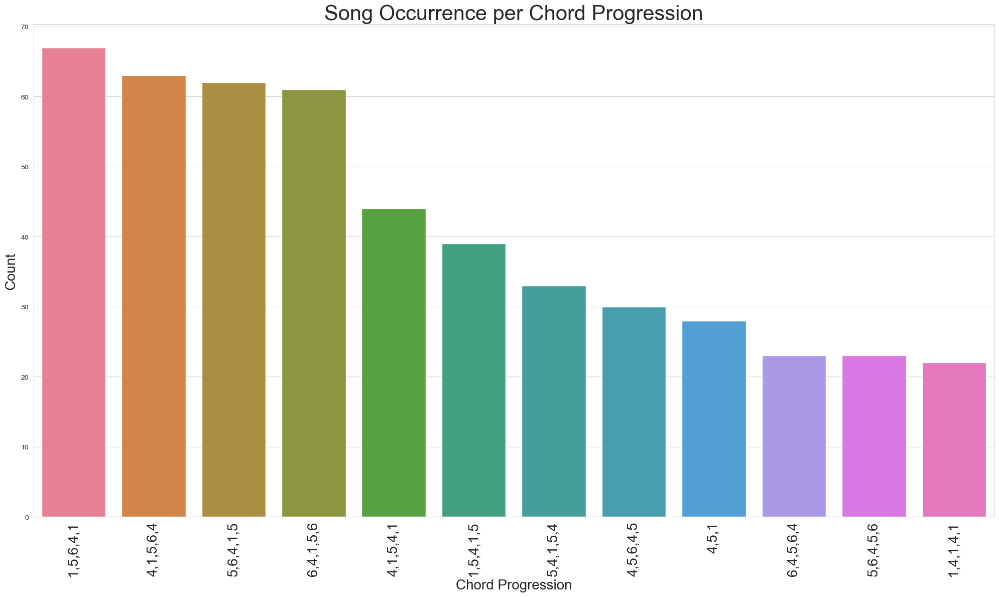

In [462]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assuming your DataFrame is loaded as common_rows.

# Count the occurrences of each unique chord progression.
chord_counts = common_rows['cp'].value_counts()

# Filter out chord progressions with counts <= 5.
chord_counts = chord_counts[chord_counts > 20]

# Set up the seaborn style.
sns.set_style("whitegrid")

# Create a color palette based on the number of unique chords.
colors = sns.color_palette("husl", len(chord_counts))

# Create the bar plot.
plt.figure(figsize=(20, 12))  # Increased figure size
sns.barplot(x=chord_counts.index, y=chord_counts.values, palette=colors)

# Set the title and labels.
plt.title('Song Occurrence per Chord Progression',fontsize=30)
plt.xlabel('Chord Progression',fontsize=20)
plt.ylabel('Count',fontsize=20)

# Rotate x labels for better visibility, adjust font size, and set horizontal alignment.
plt.xticks(rotation=90, fontsize=20, ha="center")  # Increased rotation and adjusted horizontal alignment

# Display the plot.
plt.tight_layout()
plt.show()


In [29]:
pip install joypy


Note: you may need to restart the kernel to use updated packages.


In [30]:
common_rows['cp']

0           1,5,6
1         4,1,4,1
2       6,3,4,1,5
3       5,6,3,4,1
4           1,5,6
          ...    
2668    5,6,5,4,5
2669    5,1,5,1,5
2670    5,4,5,6,1
2671    5,2,4,5,2
2672    5,2,1,5,4
Name: cp, Length: 2608, dtype: object

<Figure size 10000x6800 with 0 Axes>

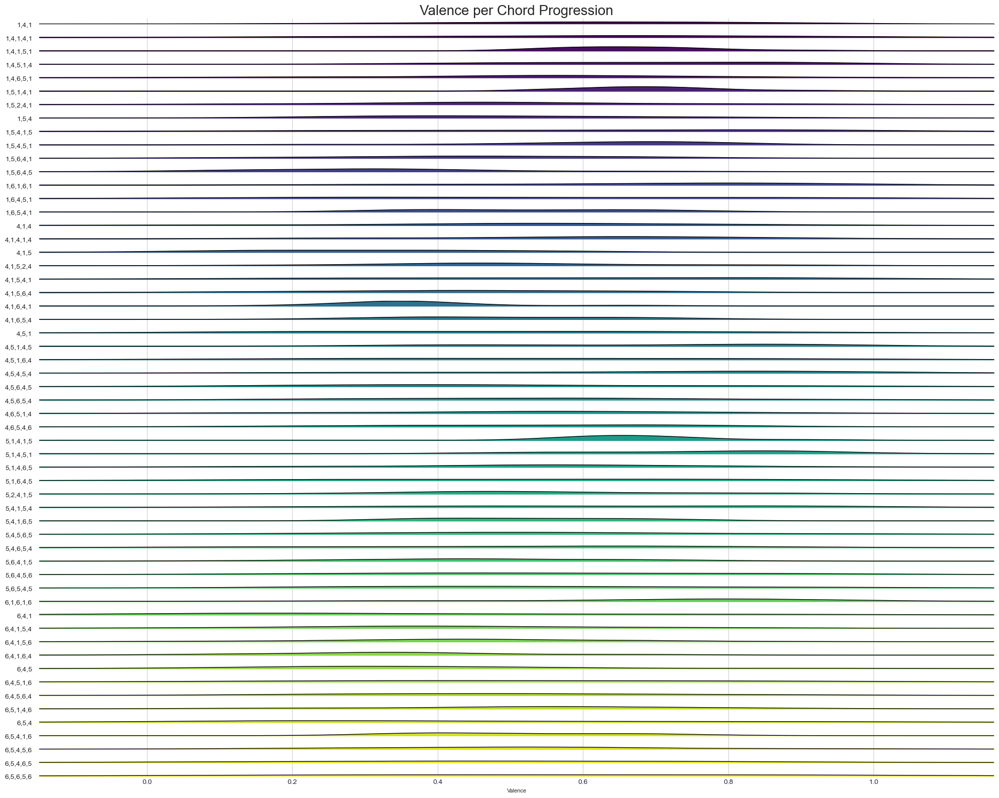

In [31]:
import pandas as pd
import matplotlib.pyplot as plt
from joypy import joyplot

# Assuming your DataFrame is loaded as common_rows.

# Get the chord counts greater than 10
chord_counts = common_rows['cp'].value_counts()
selected_chords = chord_counts[chord_counts > 10].index

# Filter the DataFrame
filtered_rows = common_rows[common_rows['cp'].isin(selected_chords)]

# Create the ridgeline plot
plt.figure(figsize=(100, 68))
fig, axes = joyplot(
    data=filtered_rows,
    column="valence",
    by="cp",
    figsize=(20, 16),
    linewidth=1,
    colormap=plt.cm.viridis,  # This will provide a gradient color similar to the one in your graph
    grid=True,
    legend=False,
    overlap=2, # Adjust as needed for spacing
    ylabels=True,
    xlabels=True,
    fill=True
)

# Adding title
plt.title('Valence per Chord Progression', fontsize=20)
plt.xlabel('Valence', fontsize=8)
plt.ylabel('Density', fontsize=8)
plt.tight_layout()
plt.show()


In [32]:

# Assuming 'common_rows' is your original DataFrame and already contains the data you want to export
selected_columns = common_rows[['cp', 'artist', 'song', 'section', 'danceability',
                                'energy', 'key', 'loudness', 'mode', 'speechiness',
                                'acousticness', 'instrumentalness', 'liveness', 'valence',
                                'tempo', 'duration_ms', 'time_signature', 'cp_length',
                                'genres', 'type']]  # Make sure all column names are exactly as they appear in your DataFrame

# Now export only the selected columns to CSV
selected_columns.to_csv('dataset.csv', index=False)

##### danceability 可舞性
number 数 [float] [浮子]
Danceability describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is most danceable.
可舞性描述了基于音乐元素的组合（包括速度、节奏稳定性、节拍强度和整体规律性）的曲目是否适合舞蹈。值 0.0 表示最不容易跳舞，1.0 表示最易跳舞。

##### energy 能源
number 数 [float] [浮子]
Energy is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale. Perceptual features contributing to this attribute include dynamic range, perceived loudness, timbre, onset rate, and general entropy.
能量是从0.0到1.0的量度，代表强度和活动的感知量度。通常，充满活力的曲目感觉快速、响亮且嘈杂。例如，死亡金属具有很高的能量，而巴赫前奏曲的音阶得分较低。影响此属性的感知特征包括动态范围、感知响度、音色、起始率和一般熵。

##### instrumentalness 工具性
number 数 [float] [浮子]
Predicts whether a track contains no vocals. "Ooh" and "aah" sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly "vocal". The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content. Values above 0.5 are intended to represent instrumental tracks, but confidence is higher as the value approaches 1.0.
预测曲目是否不包含人声。在这种情况下，“哦”和“啊”的声音被视为工具。说唱或口语曲目显然是“人声”的。乐器性值越接近 1.0，轨道不包含人声内容的可能性就越大。高于 0.5 的值旨在表示乐器音轨，但当值接近 1.0 时，置信度会更高。

##### key 钥匙
integer 整数
The key the track is in. Integers map to pitches using standard Pitch Class notation. E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on. If no key was detected, the value is -1.
曲目所在的密钥。整数映射到使用标准音高类表示法的音高。例如 0 = C、1 = C♯/D、2 = D♭，依此类推。如果未检测到任何键，则值为 -1。

##### liveness 活性
number 数 [float] [浮子]
Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live.
检测录制文件中是否存在观众。活动值越高，表示现场执行曲目的可能性就越大。高于 0.8 的值提供轨道处于活动状态的可能性很大。

Example: 0.0866 例： 0.0866


##### loudness 响度
number 数 [float] [浮子]
The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks. Loudness is the quality of a sound that is the primary psychological correlate of physical strength (amplitude). Values typically range between -60 and 0 db.
轨道的整体响度，以分贝 （dB） 为单位。响度值是整个轨道的平均值，可用于比较轨道的相对响度。响度是声音的质量，是体力（振幅）的主要心理相关性。值通常介于 -60 和 0 db 之间。

Example: -5.883 例： -5.883

##### tempo 速度
number 数 [float] [浮子]
The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration.
曲目的总体估计速度，以每分钟节拍数 （BPM） 为单位。在音乐术语中，速度是给定作品的速度或节奏，直接来自平均节拍持续时间。

##### duration_ms
integer 整数
The duration of the track in milliseconds.
轨迹的持续时间（以毫秒为单位）。

##### time_signature
integer 整数
An estimated time signature. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure). The time signature ranges from 3 to 7 indicating time signatures of "3/4", to "7/4".
估计的时间签名。拍号（米）是一种符号约定，用于指定每个小节（或度量）中的节拍数。拍号范围从 3 到 7，表示拍号为“3/4”到“7/4”。

Range: 3 - 7

##### valence 原子价
number 数 [float] [浮子]
A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).
从 0.0 到 1.0 的度量，描述曲目传达的音乐积极性。具有高价的曲目听起来更积极（例如快乐，开朗，欣快），而低价的曲目听起来更消极（例如悲伤，沮丧，愤怒）。

Range: 0 - 1

https://developer.spotify.com/documentation/web-api/reference/get-audio-features


Pitch 投
class  .class	Tonal counterparts  音调对应物	Solfege  索尔费格
0	C (also B♯, Ddouble flat)
C（也是B，D♯ double flat ）
do  做
1	C♯, D♭ (also Bdouble sharp)
C♯， D♭ （也是 B double sharp ）
2	D (also Cdouble sharp, Edouble flat)
D（也是C，E double sharp double flat ）
re  再
3	D♯, E♭ (also Fdouble flat)
D♯， E♭ （也是 F double flat ）
4	E (also Ddouble sharp, F♭)
E （也叫 D double sharp ， F♭）
mi  米
5	F (also E♯, Gdouble flat)
F （也叫 E♯， G double flat ）
fa  发
6	F♯, G♭ (also Edouble sharp)
F♯， G♭ （也是 E double sharp ）
7	G (also Fdouble sharp, Adouble flat)
G （也叫 F double sharp ， A double flat ）
sol  溶胶
8	G♯, A♭ G♯， A♭	
9	A (also Gdouble sharp, Bdouble flat)
A （也叫 G double sharp ， B double flat ）
la  洛杉矶
10, t or A
10，吨或甲
A♯, B♭ (also Cdouble flat)
A♯， B♭ （也是 C double flat ）
11, e or B
11、e 或 b
B (also Adouble sharp, C♭)
B （也是 A double sharp ， C♭）
si  四

https://en.wikipedia.org/wiki/Pitch_class


- 0: "C (C/B♯/Ddouble flat) - do"
- 1: "C♯/D♭ (C♯/D♭/Bdouble sharp)"
- 2: "D (D/Cdouble sharp/Edouble flat) - re"
- 3: "D♯/E♭ (D♯/E♭/Fdouble flat)"
- 4: "E (E/Ddouble sharp/F♭) - mi"
- 5: "F (F/E♯/Gdouble flat) - fa"
- 6: "F♯/G♭ (F♯/G♭/Edouble sharp)"
- 7: "G (G/Fdouble sharp/Adouble flat) - sol"
- 8: "G♯/A♭ - si♭/sol♯"
- 9: "A (A/Gdouble sharp/Bdouble flat) - la"
- 10: "A♯/B♭ (A♯/B♭/Cdouble flat)"
- 11: "B (B/Adouble sharp/C♭) - si"

In [33]:
pitch_class_labels = {
    0: "$C$",
    1: "$C♯/D♭$",
    2: "$D$",
    3: "$D♯/E♭$",
    4: "$E$",
    5: "$F$",
    6: "$F♯/G♭$",
    7: "$G$",
    8: "$G♯/A♭$",
    9: "$A$",
    10: "$A♯/B♭$",
    11: "$B$"
}


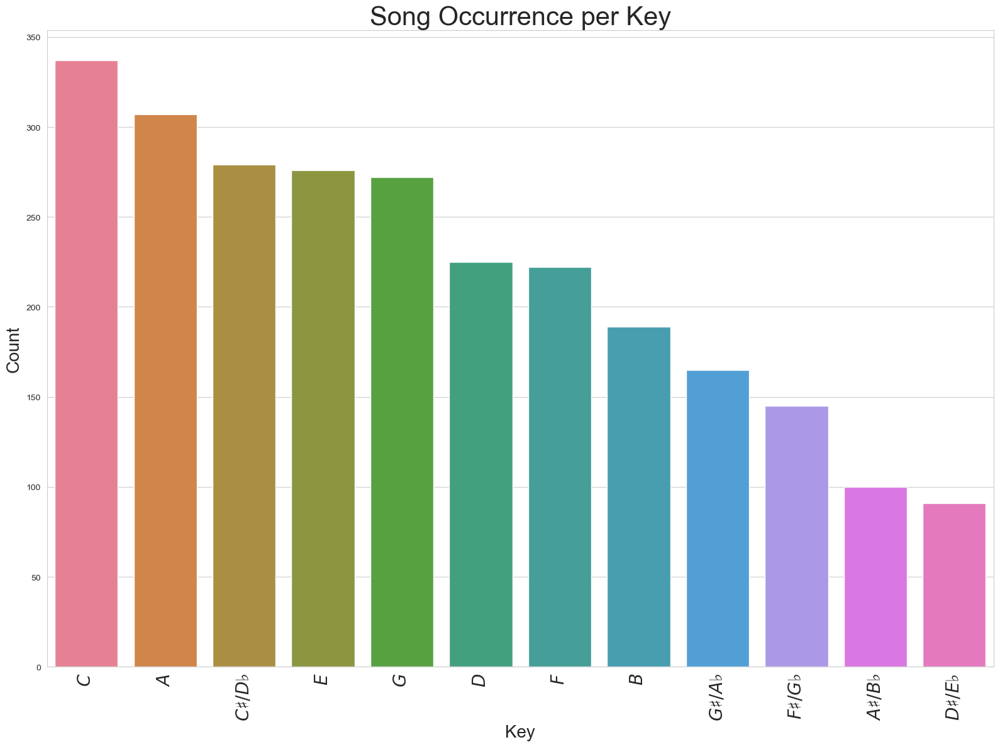

In [458]:
# Convert the 'key' column values to their respective labels
common_rows['key_labels'] = common_rows['key'].map(pitch_class_labels)

# Count the occurrences of each unique chord progression.
key_counts = common_rows['key_labels'].value_counts()

# Set up the seaborn style.
sns.set_style("whitegrid")

# Create a color palette based on the number of unique chords.
colors = sns.color_palette("husl", len(key_counts))

# Create the bar plot.
plt.figure(figsize=(16, 12))  # Increased figure size
sns.barplot(x=key_counts.index, y=key_counts.values, palette=colors)

# Set the title and labels.
plt.title('Song Occurrence per Key',fontsize=30)
plt.xlabel('Key', fontsize=20)
plt.ylabel('Count', fontsize=20)

# Rotate x labels for better visibility, adjust font size, and set horizontal alignment.
plt.xticks(rotation=90, fontsize=20, ha="center")  # Increased rotation and adjusted horizontal alignment

# Display the plot.
plt.tight_layout()
plt.show()


<Figure size 1600x1200 with 0 Axes>

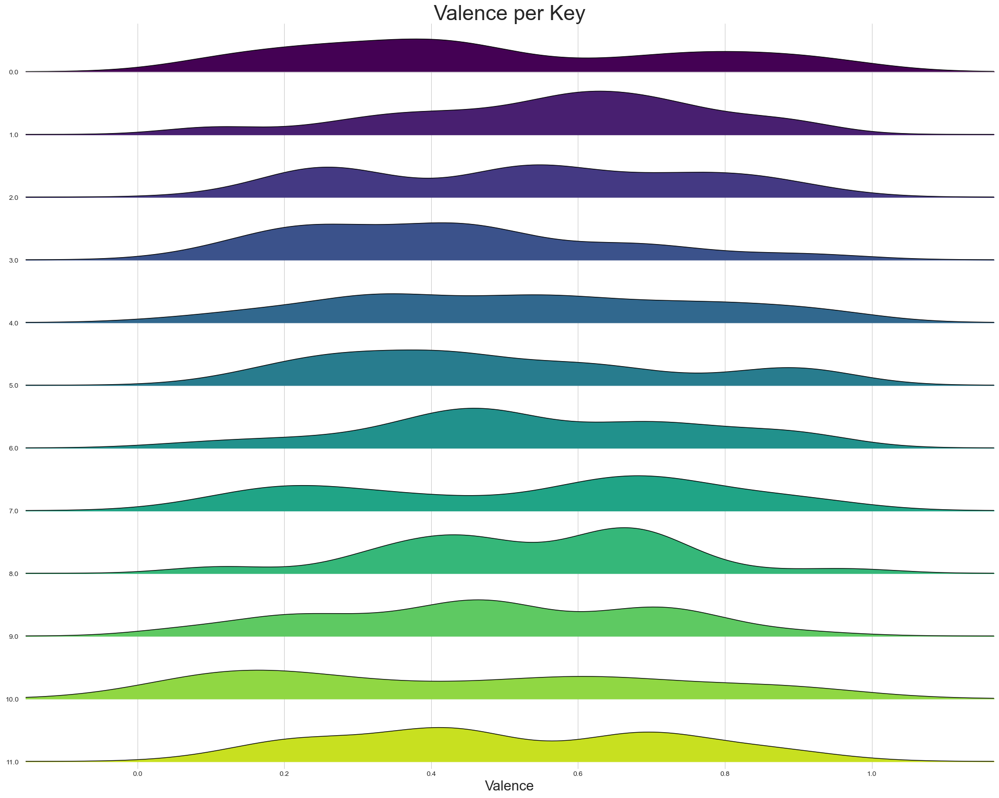

In [467]:
import pandas as pd
import matplotlib.pyplot as plt
from joypy import joyplot

# Assuming your DataFrame is loaded as common_rows.

# Get the key counts greater than 5
key_counts = common_rows['key'].value_counts()
selected_keys = key_counts[key_counts > 5].index

# Filter the DataFrame based on the selected keys
filtered_rows = common_rows[common_rows['key'].isin(selected_keys)]

# Create the ridgeline plot
plt.figure(figsize=(16, 12))
fig, axes = joyplot(
    data=filtered_rows,
    column="valence",
    by="key",
    figsize=(20, 16),
    linewidth=1,
    colormap=plt.cm.viridis,  # This will provide a gradient color similar to the one in your graph
    grid=True,
    legend=False,
    overlap=2,  # Adjust as needed for spacing
    ylabels=True,
    xlabels=True,
    fill=True
)

# Adding title
plt.title('Valence per Key', fontsize=30)
plt.xlabel('Valence', fontsize=20)
plt.ylabel('Density', fontsize=20)
plt.tight_layout()
plt.show()


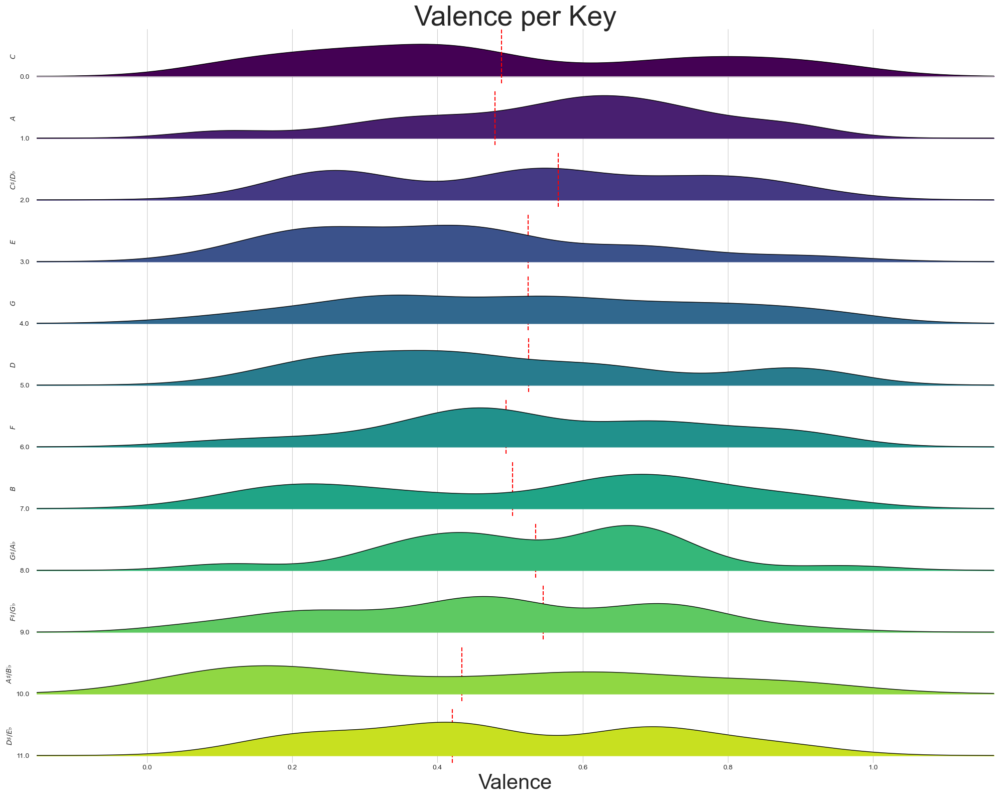

In [465]:
import pandas as pd
import matplotlib.pyplot as plt
from joypy import joyplot

# Assuming your DataFrame is loaded as common_rows.

# Define the pitch_class_labels
pitch_class_labels = {
    0: "$C$",
    1: "$C♯/D♭$",
    2: "$D$",
    3: "$D♯/E♭$",
    4: "$E$",
    5: "$F$",
    6: "$F♯/G♭$",
    7: "$G$",
    8: "$G♯/A♭$",
    9: "$A$",
    10: "$A♯/B♭$",
    11: "$B$"
}

# Get the key counts greater than 5
key_counts = common_rows['key'].value_counts()
selected_keys = key_counts[key_counts > 5].index

# Filter the DataFrame based on the selected keys
filtered_rows = common_rows[common_rows['key'].isin(selected_keys)]

# Create the ridgeline plot
fig, axes = joyplot(
    data=filtered_rows,
    column="valence",
    by="key",
    figsize=(20, 16),
    linewidth=1,
    colormap=plt.cm.viridis,
    grid=True,
    legend=False,
    overlap=2,  # Adjust as needed for spacing
    ylabels=True,
    xlabels=True,
    fill=True
)

# Calculate mean valence for each key and draw red vertical line at that position
for ax, key in zip(axes, selected_keys):
    mean_valence = filtered_rows[filtered_rows['key'] == key]['valence'].mean()
    ax.axvline(mean_valence, color='red', linestyle='--')
    # Set the y-label based on pitch_class_labels
    ax.set_ylabel(pitch_class_labels[key])

# Adding title
plt.title('Valence per Key', fontsize=20)
plt.xlabel('Valence', fontsize=20)
plt.ylabel('Valence', fontsize=20)
plt.tight_layout()
plt.show()



In [37]:
print(common_rows['genres'].head(50))


0           [album rock, classic rock, hard rock, rock]
1           [album rock, classic rock, hard rock, rock]
2           [album rock, classic rock, hard rock, rock]
3           [album rock, classic rock, hard rock, rock]
4                       [dance pop, pop, post-teen pop]
5                       [dance pop, pop, post-teen pop]
6                       [dance pop, pop, post-teen pop]
7                       [dance pop, pop, post-teen pop]
8                       [dance pop, pop, post-teen pop]
9     [british invasion, merseybeat, psychedelic roc...
10    [british invasion, merseybeat, psychedelic roc...
11    [british invasion, merseybeat, psychedelic roc...
12    [british invasion, merseybeat, psychedelic roc...
13    [british invasion, merseybeat, psychedelic roc...
14    [british invasion, merseybeat, psychedelic roc...
15    [british invasion, merseybeat, psychedelic roc...
16                              [pop rock, post-grunge]
17    [alternative rock, funk metal, permanent w

In [38]:
common_rows.columns

Index(['cp', 'artist', 'song', 'section', 'spotify_ID', 'danceability',
       'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms',
       'time_signature', 'cp_length', 'genres', 'link', 'text', 'chorus',
       'verse', 'text_1', 'text_2', 'type', 'key_labels'],
      dtype='object')

In [39]:
pip install pandas seaborn matplotlib


Note: you may need to restart the kernel to use updated packages.


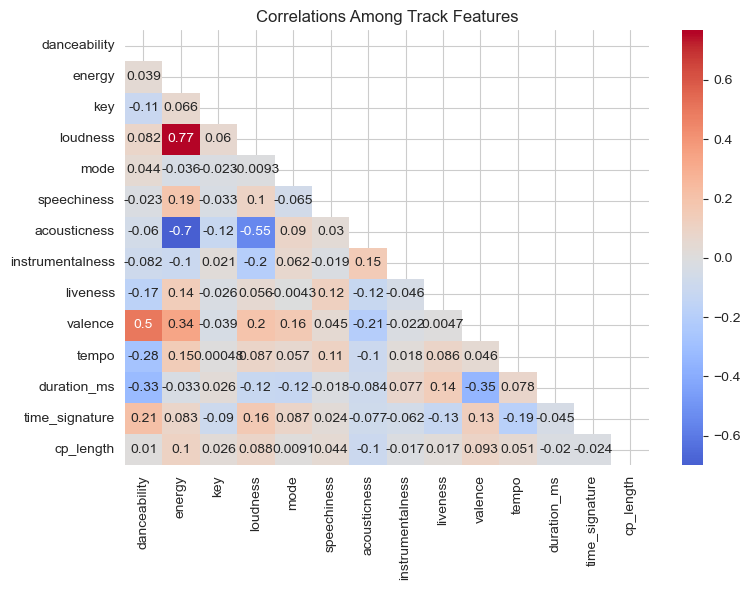

In [468]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df is already defined with your data

# Extract the specified columns
selected_columns = ['danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 
                    'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms', 
                    'time_signature', 'cp_length']
df_selected = common_rows[selected_columns]

# Calculate the correlation matrix
corr = df_selected.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
plt.figure(figsize=(8, 6))

# Generate a heatmap
sns.heatmap(corr, annot=True, cmap='coolwarm', center=0, mask=mask)

# Customize the plot appearance
plt.title("Correlations Among Track Features")
plt.tight_layout()

# Show the plot
plt.show()




In [41]:
import ast

In [52]:
common_rows['genres']

0             [album rock, classic rock, hard rock, rock]
1             [album rock, classic rock, hard rock, rock]
2             [album rock, classic rock, hard rock, rock]
3             [album rock, classic rock, hard rock, rock]
4                         [dance pop, pop, post-teen pop]
                              ...                        
2668                                     [dance pop, pop]
2669    [british invasion, merseybeat, psychedelic roc...
2670                      [dance pop, pop, post-teen pop]
2671                                     [dance pop, pop]
2672    [album rock, art rock, classic rock, progressi...
Name: genres, Length: 2608, dtype: object

In [51]:
common_rows['type'].value_counts().head(50)

type
dance pop               617
album rock              478
pop                     193
permanent wave          126
alternative rock        111
alternative metal        72
british invasion         69
glam rock                62
adult standards          49
boy band                 43
modern rock              42
dance rock               41
art pop                  38
canadian pop             35
irish rock               34
europop                  34
neo mellow               34
celtic                   30
australian dance         29
finnish metal            26
german metal             21
contemporary country     21
comedy rock              21
indie pop                20
hard rock                20
classic rock             17
reggae                   16
glam metal               16
art rock                 15
pop punk                 14
australian rock          14
folk rock                14
canadian folk            13
australian pop           13
indie rock               13
alternative cou

In [54]:
import pandas as pd

# Assuming common_rows is your DataFrame

def label_genre(row):
    genres = ['rock', 'pop', 'metal', 'alternative', 'country']
    for genre in genres:
        if genre in row.lower():
            return genre
    return 'other'

# Apply the function to the 'type' column to create a new 'label' column
common_rows['label'] = common_rows['type'].apply(label_genre)

common_rows['label'] 


0        rock
1        rock
2        rock
3        rock
4         pop
        ...  
2668      pop
2669    other
2670      pop
2671      pop
2672     rock
Name: label, Length: 2608, dtype: object

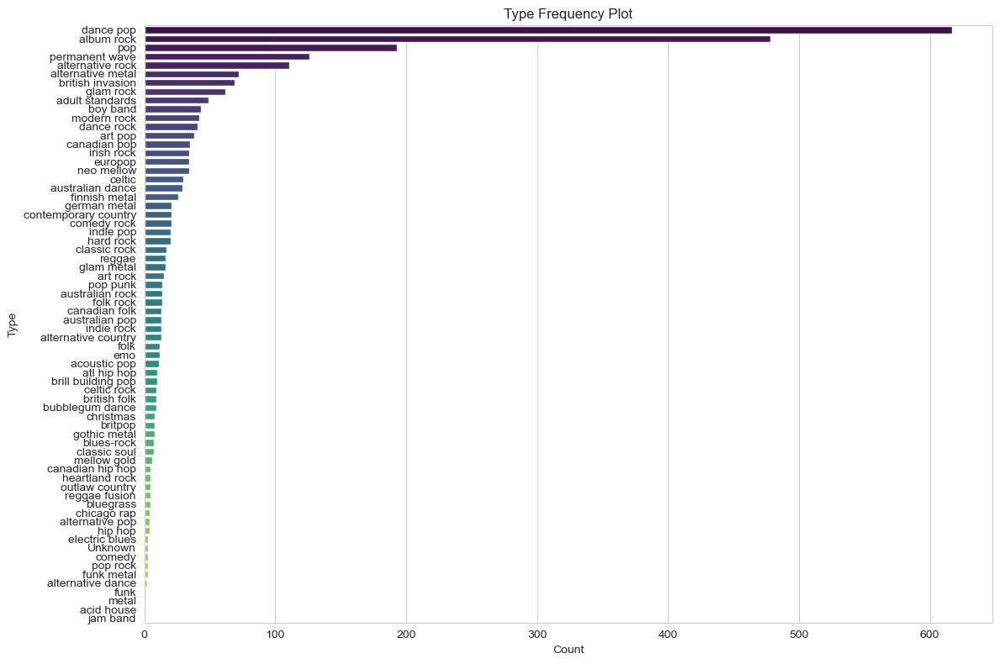

In [56]:
# Plotting the frequency plot
plt.figure(figsize=(12, 8))
sns.countplot(data=common_rows, y='type', order=common_rows['type'].value_counts().index, palette="viridis")
plt.title("Type Frequency Plot", fontsize=12)
plt.xlabel("Count", fontsize=10)
plt.ylabel("Type", fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()

plt.show()

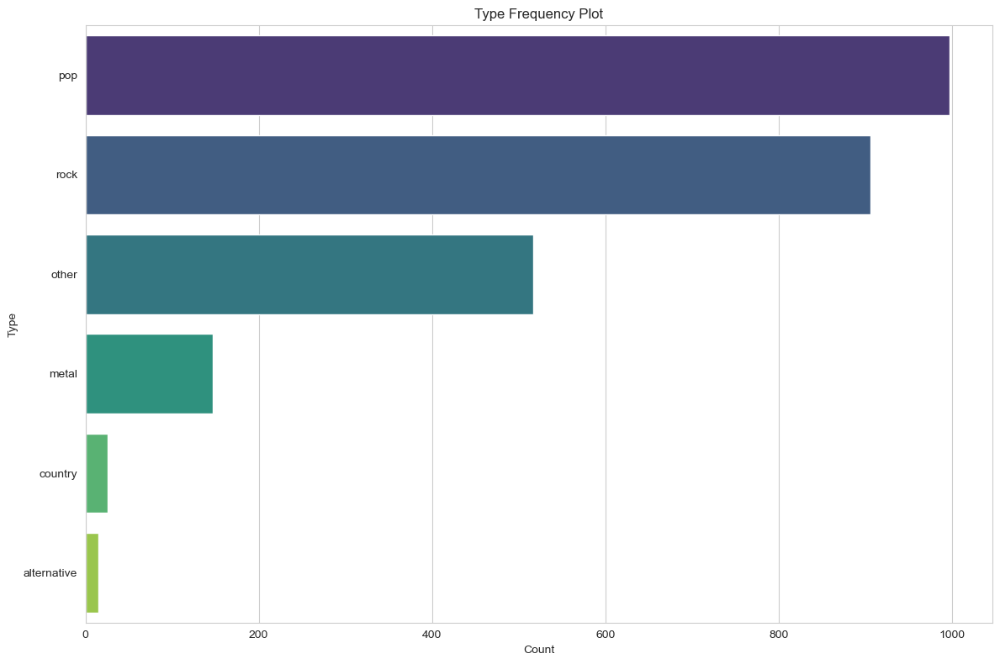

In [55]:
# Plotting the frequency plot
plt.figure(figsize=(12, 8))
sns.countplot(data=common_rows, y='label', order=common_rows['label'].value_counts().index, palette="viridis")
plt.title("Type Frequency Plot", fontsize=12)
plt.xlabel("Count", fontsize=10)
plt.ylabel("Type", fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()

plt.show()

In [83]:
common_rows.shape

(2608, 29)

In [66]:
common_rows['text_2'][1999:2000]

2052    My my\nOh yeah\nWaterloo - I was defeated, you...
Name: text_2, dtype: object

In [277]:
common_rows.columns

Index(['cp', 'artist', 'song', 'section', 'spotify_ID', 'danceability',
       'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms',
       'time_signature', 'cp_length', 'genres', 'link', 'text', 'chorus',
       'verse', 'text_1', 'text_2', 'type', 'key_labels', 'label', 'clusters',
       'cleaned_text', 'sentiment'],
      dtype='object')

## Clean text and generate wordcloud 

In [278]:
# Define the function to implement POS tagging:
def get_wordnet_pos(pos_tag):
    if pos_tag.startswith('J'):
        return wordnet.ADJ
    elif pos_tag.startswith('V'):
        return wordnet.VERB
    elif pos_tag.startswith('N'):
        return wordnet.NOUN
    elif pos_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN


In [281]:
# Define the main function to clean text in various ways:
def clean_text(text):
    # Remove carriage returns (\r\n) and new lines (\n)
    text = re.sub(r'\r\n|\n', ' ', text)  # Replaces \r\n and \n with a space

    # Existing regex expressions
    text = re.sub('@[^\s]+', '', text)
    text = re.sub('((www\.[^\s]+)|(https?://[^\s]+))', '', text)
    text = re.sub(r'#([^\s]+)', '', text)

    # Convert text to lowercase
    text = text.lower()

    # Tokenize text and remove punctuation
    text = [word.strip(string.punctuation) for word in text.split(" ")]

    # Remove numbers
    text = [word for word in text if not any(c.isdigit() for c in word)]

    # Remove stop words
    stop = stopwords.words('english')
    text = [x for x in text if x not in stop]

    # Remove empty tokens
    text = [t for t in text if len(t) > 0]

    # POS tag text and lemmatize text
    pos_tags = pos_tag(text)
    text = [WordNetLemmatizer().lemmatize(t[0], get_wordnet_pos(t[1])) for t in pos_tags]

    # Remove words with only one letter
    text = [t for t in text if len(t) > 1]

    # Join all
    text = " ".join(text)

    return text

In [372]:
df = common_rows

# Apply function on the column 'text':
df['cleaned_text'] = df['text_2'].apply(lambda x: clean_text(x))

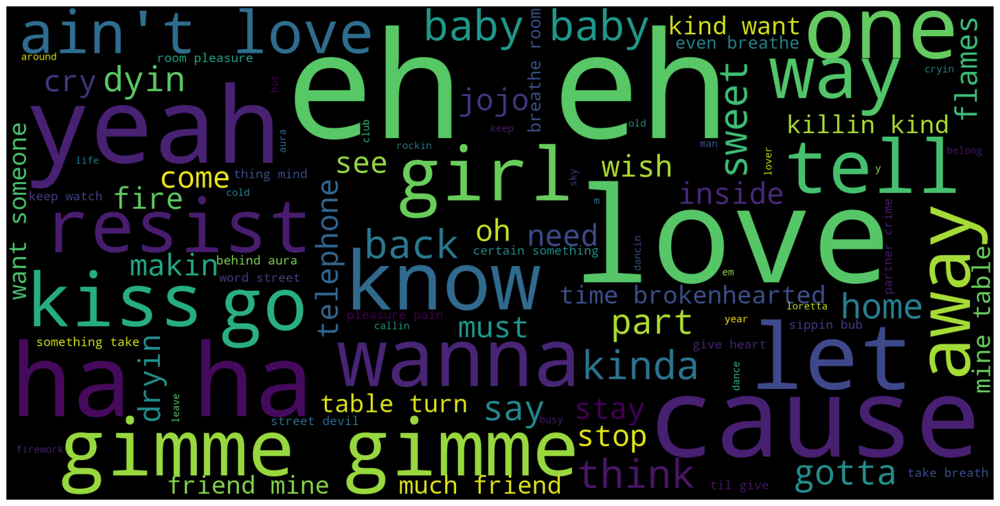

In [283]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color = 'black',
        max_words = 400,
        max_font_size = 60, 
        scale = 5,
        random_state = 42
    ).generate(str(data))

    fig = plt.figure(1, figsize = (20, 15))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize = 20)
        fig.subplots_adjust(top = 2.3)

    plt.imshow(wordcloud)
    plt.show()
    
# print wordcloud
show_wordcloud(df['cleaned_text'])

## Bag of words method 

In [289]:
bin_vect = CountVectorizer(stop_words='english', min_df=15, binary=True)
bin_dtm = bin_vect.fit_transform(df['cleaned_text'])

In [290]:
term_indices = {index: term for term, index in bin_vect.vocabulary_.items()}
colterms = [term_indices[i] for i in range(bin_dtm.shape[1])]

##### the word frequency (occured in all the document)

In [292]:
doc_freq = pd.DataFrame(bin_dtm.toarray(), columns=colterms).agg('sum', axis='rows')
doc_freq

abandon       17
ache          24
act           16
action        16
admit         15
            ... 
year         104
yes          111
yesterday     35
young         87
youth         18
Length: 798, dtype: int64

##### word frequency - in particular document 

In [293]:
count_vect = CountVectorizer(stop_words='english', min_df=15, binary=False)
count_dtm = count_vect.fit_transform(df['cleaned_text'])

In [294]:
count_dtm

<2608x798 sparse matrix of type '<class 'numpy.int64'>'
	with 52960 stored elements in Compressed Sparse Row format>

In [295]:
doc100 = df['cleaned_text'][100]
doc100

"want break free i've get break free"

In [296]:
tf = count_dtm[100].toarray()[0]

In [299]:
tfidf = pd.DataFrame({'term':colterms, 'term_freq':tf, 'doc_freq':doc_freq}).reset_index(drop=True)

In [300]:
def get_idf(N, df):
    return np.log((N)/(df)) + 1 # inverse document frequency 

def get_idf_smooth(N, df):
    return np.log((1 + N)/(1 + df)) + 1

def get_tfidf(tf, idf):
    return tf*idf

In [301]:
tfidf['idf'] = get_idf(2608, tfidf['doc_freq'])
tfidf['tfidf'] = get_tfidf(tfidf['term_freq'], tfidf['idf'])
tfidf['idf_sm'] = get_idf_smooth(2608, tfidf['doc_freq'])
tfidf['tfidf_sm'] = get_tfidf(tfidf['term_freq'], tfidf['idf_sm'])

In [303]:
import csv
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer 
from sklearn.feature_extraction.text import TfidfVectorizer

In [304]:
# Convert count dtm to tfidf without smoothing
transformer = TfidfTransformer(norm=None, smooth_idf=False, use_idf=True)
tfidf_dtm = transformer.fit_transform(count_dtm)

In [305]:
tfidf['sklearn_tfidf'] = pd.DataFrame({'tfidf':pd.Series(tfidf_dtm[100].toarray()[0])})
tfidf.sort_values(by='tfidf', ascending=False).head(50)

,term,term_freq,doc_freq,idf,tfidf,idf_sm,tfidf_sm,sklearn_tfidf
260,free,2,129,4.006527,8.013053,3.999188,7.998376,8.013053
80,break,2,289,3.199912,6.399824,3.196841,6.393683,6.399824
744,ve,1,477,2.698822,2.698822,2.697112,2.697112,2.698822
755,want,1,506,2.639802,2.639802,2.638211,2.638211,2.639802
0,abandon,0,17,6.033126,0.000000,5.976351,0.000000,0.000000
534,realize,0,41,5.152767,0.000000,5.129053,0.000000,0.000000
526,rain,0,71,4.603659,0.000000,4.590056,0.000000,0.000000
527,rainbow,0,24,5.688285,0.000000,5.647846,0.000000,0.000000
528,raise,0,22,5.775296,0.000000,5.731228,0.000000,0.000000
529,reach,0,21,5.821816,0.000000,5.775680,0.000000,0.000000


In [307]:
tfidf_normed = tfidf[['term', 'term_freq', 'idf', 'tfidf','tfidf_sm']].copy()
l2norm = np.linalg.norm(tfidf_normed['tfidf'])
tfidf_normed['tfidf_l2'] = tfidf_normed['tfidf']/l2norm
tfidf_normed

,term,term_freq,idf,tfidf,tfidf_sm,tfidf_l2
0,abandon,0,6.033126,0.0,0.0,0.0
1,ache,0,5.688285,0.0,0.0,0.0
2,act,0,6.093750,0.0,0.0,0.0
3,action,0,6.093750,0.0,0.0,0.0
4,admit,0,6.158289,0.0,0.0,0.0
...,...,...,...,...,...,...
793,year,0,4.221948,0.0,0.0,0.0
794,yes,0,4.156809,0.0,0.0,0.0
795,yesterday,0,5.310991,0.0,0.0,0.0
796,young,0,4.400431,0.0,0.0,0.0


In [308]:
transformer = TfidfTransformer(norm='l2', smooth_idf=False, use_idf=True)
tfidf_dtm_l2 = transformer.fit_transform(count_dtm)

In [310]:
tfidf_normed['sklearn_tfidf_l2'] = pd.DataFrame({'tfidf':pd.Series(tfidf_dtm_l2[100].toarray()[0])})
tfidf_normed.sort_values(by='tfidf', ascending=False).head(10)

,term,term_freq,idf,tfidf,tfidf_sm,tfidf_l2,sklearn_tfidf_l2
260,free,2,4.006527,8.013053,7.998376,0.733266,0.733266
80,break,2,3.199912,6.399824,6.393683,0.585641,0.585641
744,ve,1,2.698822,2.698822,2.697112,0.246966,0.246966
755,want,1,2.639802,2.639802,2.638211,0.241565,0.241565
0,abandon,0,6.033126,0.000000,0.000000,0.000000,0.000000
534,realize,0,5.152767,0.000000,0.000000,0.000000,0.000000
526,rain,0,4.603659,0.000000,0.000000,0.000000,0.000000
527,rainbow,0,5.688285,0.000000,0.000000,0.000000,0.000000
528,raise,0,5.775296,0.000000,0.000000,0.000000,0.000000
529,reach,0,5.821816,0.000000,0.000000,0.000000,0.000000


#### KNN clustering 

In [311]:
from sklearn.cluster import KMeans

In [312]:
bow_matrix = count_dtm

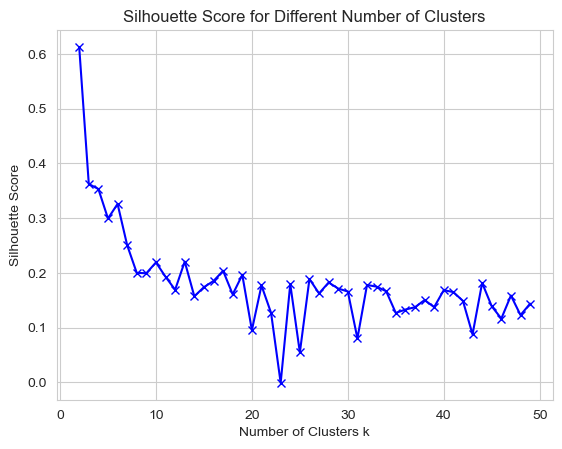

In [314]:
import warnings

# Suppress warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import CountVectorizer

# Range of k (number of clusters) to try
range_n_clusters = range(2,50)

# List to store silhouette scores
silhouette_avg = []

for n_clusters in range_n_clusters:
    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(bow_matrix)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg.append(silhouette_score(bow_matrix, cluster_labels))

# Plotting the silhouette scores
plt.plot(range_n_clusters, silhouette_avg, 'bx-')
plt.xlabel('Number of Clusters k')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Different Number of Clusters')
plt.show()

In [315]:
top_10_values_indices = sorted(range(len(silhouette_avg)), key=lambda i: silhouette_avg[i], reverse=True)[:20]
top_10_values = [silhouette_avg[i] for i in top_10_values_indices]

# Printing the results
for i, value in zip(top_10_values_indices, top_10_values):
    print(f"Index: {i}, Value: {value}")

Index: 0, Value: 0.6129515057170045
Index: 1, Value: 0.362539877973729
Index: 2, Value: 0.3533900117588048
Index: 4, Value: 0.3261161420476879
Index: 3, Value: 0.29952066844418146
Index: 5, Value: 0.25070685001392234
Index: 11, Value: 0.22081189105455848
Index: 8, Value: 0.21926828901065562
Index: 15, Value: 0.20393957600108453
Index: 6, Value: 0.20015564913105727
Index: 7, Value: 0.1994990673800037
Index: 17, Value: 0.1964846028891152
Index: 9, Value: 0.19303813206976322
Index: 24, Value: 0.18895359849517326
Index: 14, Value: 0.18532941475198925
Index: 26, Value: 0.18258303094685452
Index: 42, Value: 0.181860245738708
Index: 22, Value: 0.17967432142298848
Index: 30, Value: 0.17809012534352234
Index: 19, Value: 0.17710190127992767


In [318]:
num_clusters = 20
km_model = KMeans(n_clusters=num_clusters)
km_model.fit(bow_matrix)

KMeans(n_clusters=20)

In [324]:
df['knn_clusters'] = km_model.labels_
df['knn_clusters'].value_counts()

knn_clusters
8     1825
7      274
2      255
6       69
5       50
17      35
12      13
3       13
11      12
1        9
14       8
15       7
18       6
9        6
13       6
0        5
10       5
16       4
4        3
19       3
Name: count, dtype: int64

In [363]:
df_bow = pd.DataFrame(bow_matrix.toarray(), columns= count_vect.get_feature_names_out())

# df_bow.columns = ["word_" + str(x) for x in df_bow.columns]

df_bow.index = df.index

data = pd.concat([df, df_bow], axis = 1) 


In [364]:
data.tail(2)

,cp,artist,song,section,spotify_ID,danceability,energy,key,loudness,mode,...,wound,write,wrong,ya,yeah,year,yes,yesterday,young,youth
2671,"5,2,4,5,2",lady gaga,telephone,chorus,1IaYWv32nFFMdljBIjMY5T,0.827,0.821,3.0,-5.864,1.0,...,0,0,0,0,0,0,0,0,0,0
2672,"5,2,1,5,4",pink floyd,wish you were here,verse,6mFkJmJqdDVQ1REhVfGgd1,0.481,0.262,7.0,-15.730,1.0,...,0,0,0,0,0,2,0,0,0,0


In [327]:
# Add cluster assignments
df_bow['clusters'] = df['knn_clusters']

# Calculating centroids
centroids = df_bow.groupby('clusters').mean()

# Displaying key words for each cluster
for cluster in centroids.index:
    print(f"Cluster {cluster}:")
    top_words = centroids.loc[cluster].sort_values(ascending=False).head(3)  # Top 3 words
    print(top_words)

Cluster 0.0:
thing     14.0
worry     12.0
little     6.0
Name: 0.0, dtype: float64
Cluster 1.0:
want    11.0
free     7.0
know     6.0
Name: 1.0, dtype: float64
Cluster 2.0:
know    0.954918
oh      0.758197
like    0.659836
Name: 2.0, dtype: float64
Cluster 3.0:
la       9.692308
brown    1.384615
girl     1.384615
Name: 3.0, dtype: float64
Cluster 4.0:
dream     1.0
little    1.0
nation    1.0
Name: 4.0, dtype: float64
Cluster 5.0:
oh      4.06
love    1.68
know    1.32
Name: 5.0, dtype: float64
Cluster 6.0:
love    1.691176
know    0.573529
like    0.558824
Name: 6.0, dtype: float64
Cluster 7.0:
love    1.070896
like    0.895522
know    0.876866
Name: 7.0, dtype: float64
Cluster 8.0:
know    0.594276
love    0.593154
like    0.437710
Name: 8.0, dtype: float64
Cluster 9.0:
love    2.500000
mama    1.666667
know    1.500000
Name: 9.0, dtype: float64
Cluster 10.0:
make     1.4
ah       1.2
think    0.8
Name: 10.0, dtype: float64
Cluster 11.0:
feel     1.750000
ve       1.500000
world 

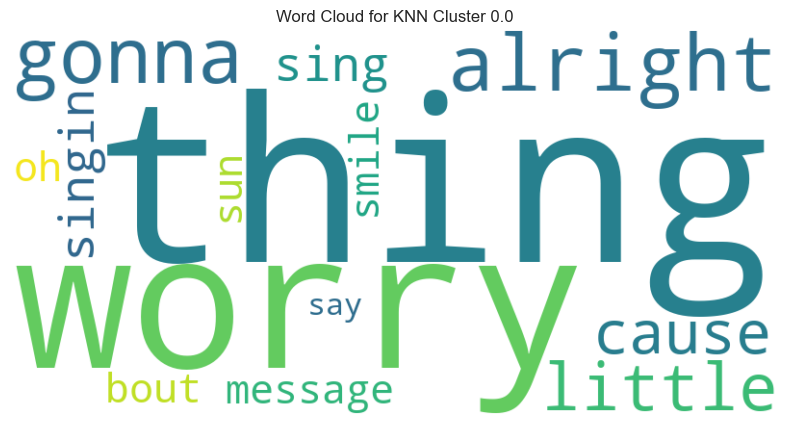

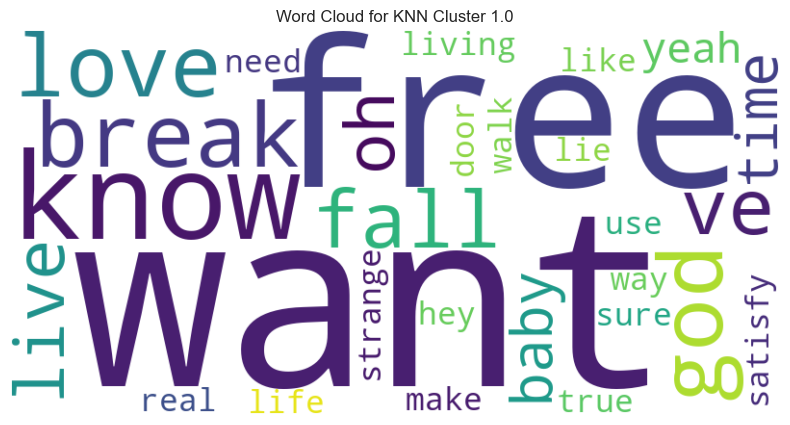

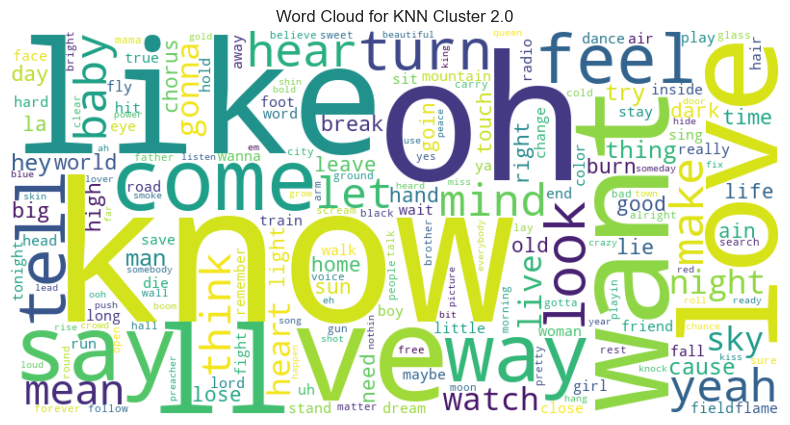

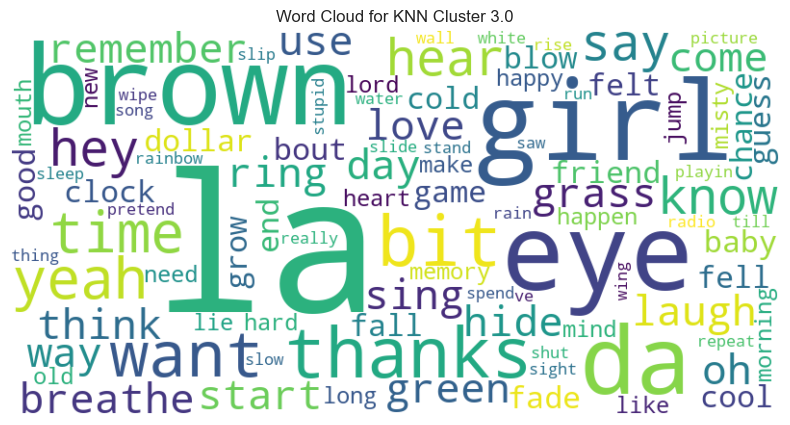

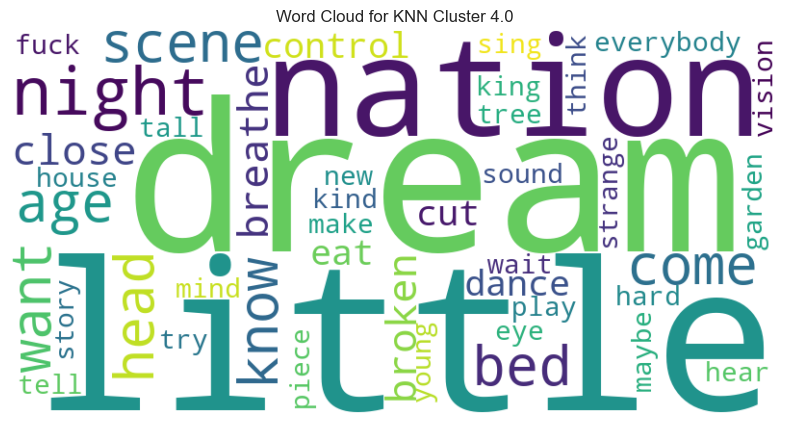

...

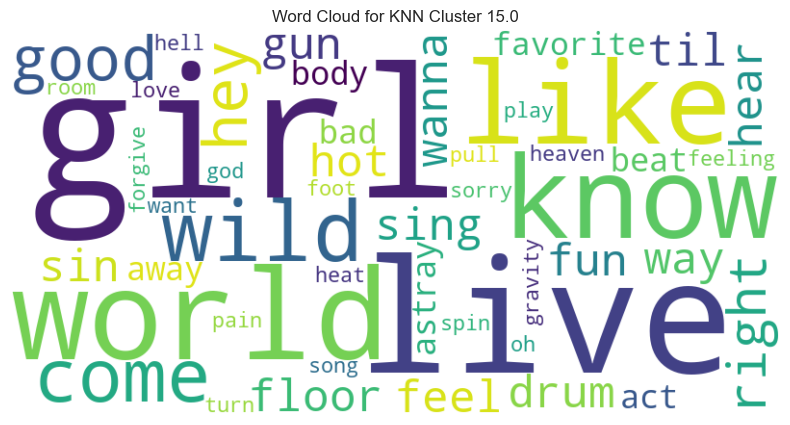

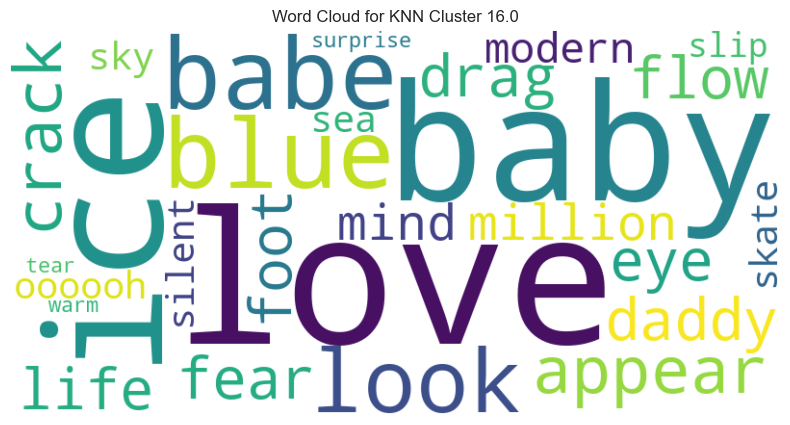

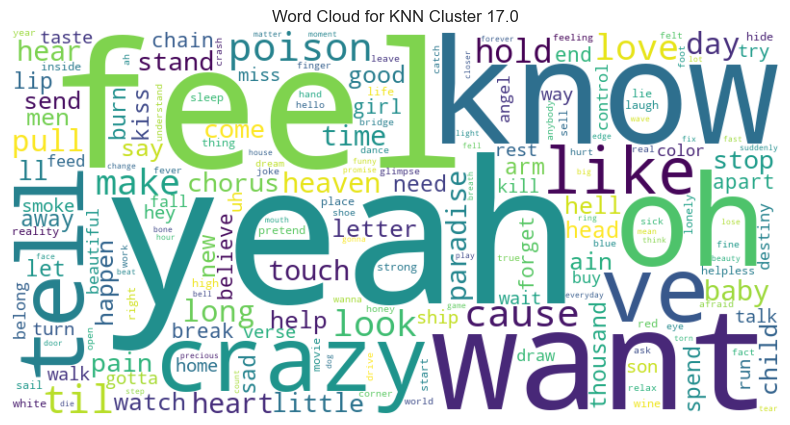

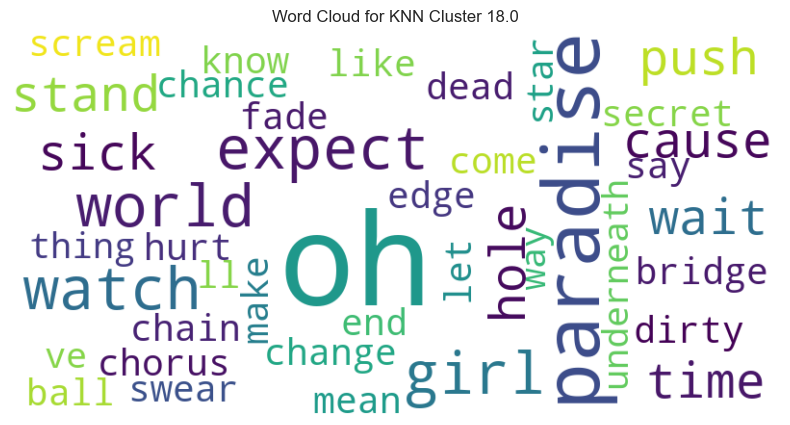

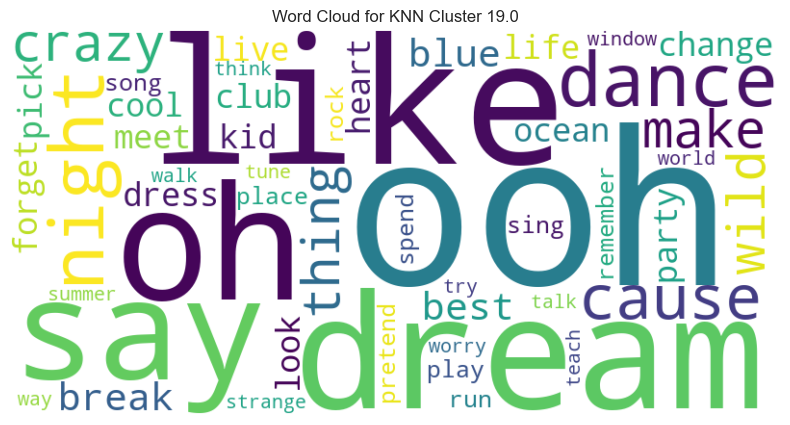

In [338]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt


# For each cluster, generate a word cloud based on the word frequencies
for cluster in centroids.index:
    # Get the word frequencies for this cluster
    word_freq = centroids.loc[cluster].to_dict()
    
    # Create a WordCloud object
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    
    # Generate the word cloud from word frequencies
    wordcloud.generate_from_frequencies(word_freq)
    
    # Plot the word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for KNN Cluster {cluster}')
    plt.axis("off")
    plt.show()



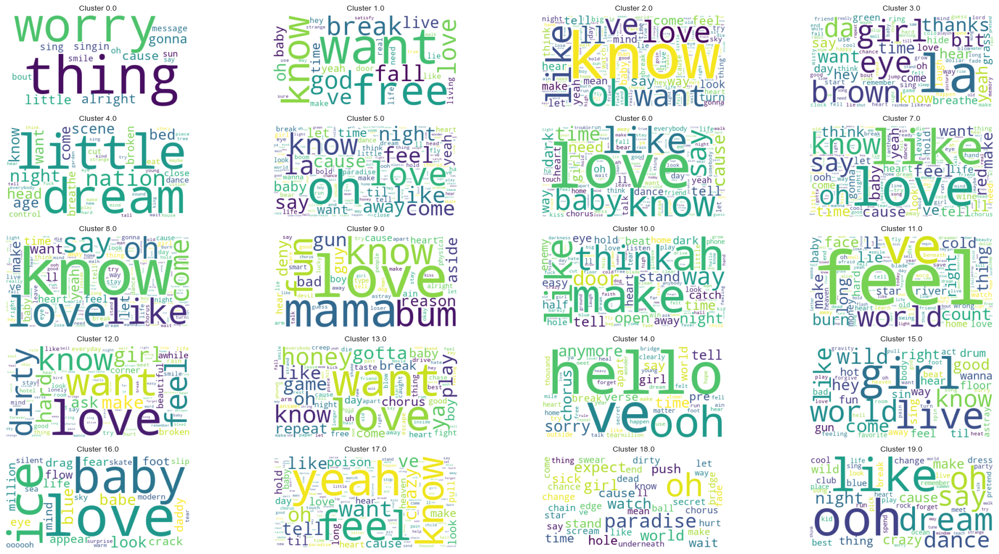

In [339]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assuming 'centroids' is a DataFrame where each row corresponds to a cluster centroid and columns are word frequencies.

# Set up the grid
num_clusters = len(centroids)
num_rows = int(np.ceil(np.sqrt(num_clusters)))
num_cols = int(np.ceil(num_clusters / num_rows))

# Create a grid for subplots
plt.figure(figsize=(20, 10))
gs = gridspec.GridSpec(num_rows, num_cols)

# Create a word cloud for each cluster and place it on the grid
for i, cluster in enumerate(centroids.index):
    ax = plt.subplot(gs[i])
    word_freq = centroids.loc[cluster].to_dict()
    wordcloud = WordCloud(width=400, height=200, background_color='white')
    wordcloud.generate_from_frequencies(word_freq)
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.set_title(f'Cluster {cluster}', fontsize=10)
    ax.axis('off')

# Adjust layout
plt.tight_layout()
plt.show()


####  Hierarchical clustering 

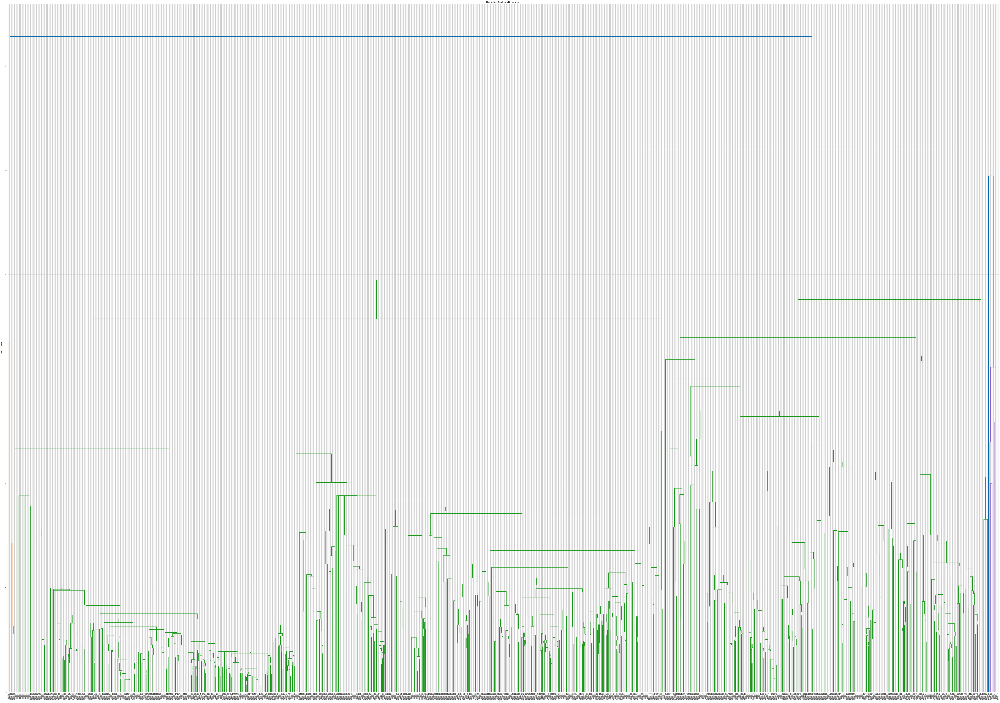

In [343]:
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt

# Hierarchical clustering
Z = linkage(df_bow, method='ward', metric='euclidean')

# Plot the dendrogram
plt.figure(figsize=(100, 70))
plt.title("Hierarchical Clustering Dendrogram")
dendrogram(Z, labels=[f"Document {i+1}" for i in range(len(df['cleaned_text']))])
plt.xlabel("Document")
plt.ylabel("Distance (Ward)")
plt.show()

In [359]:
# Flattening the dendrogram by choosing a cutoff threshold that results in a desired number of clusters
max_d = 49 # for instance, found by visual inspection of the dendrogram
clusters = fcluster(Z, max_d, criterion='distance')

# Add these cluster labels to your DataFrame
df['hierarchical_clusters'] = clusters

df['hierarchical_clusters'].value_counts()

hierarchical_clusters
3     1699
10     266
11     254
14     156
7       50
9       36
12      30
16      20
8       16
2       13
4       12
6       12
18      12
19       9
15       5
13       5
1        5
17       4
20       3
5        1
Name: count, dtype: int64

In [365]:
df_bow_h = df_bow 

# Add cluster assignments
df_bow_h['clusters_h'] = df['hierarchical_clusters']

# Calculating centroids
centroids = df_bow_h.groupby('clusters_h').mean()

# Displaying key words for each cluster
for cluster in centroids.index:
    print(f"Cluster {cluster}:")
    top_words = centroids.loc[cluster].sort_values(ascending=False).head(3)  # Top 3 words
    print(top_words)

Cluster 1:
oh          31.0
la          17.0
paradise     5.0
Name: 1, dtype: float64
Cluster 2:
oh      16.538462
yeah     2.769231
tell     1.846154
Name: 2, dtype: float64
Cluster 3:
know    0.359623
ll      0.315480
say     0.311360
Name: 3, dtype: float64
Cluster 4:
la       11.000000
eye       1.500000
brown     1.333333
Name: 4, dtype: float64
Cluster 5:
la     46.0
bit     6.0
da      5.0
Name: 5, dtype: float64
Cluster 6:
say       5.0
anthem    5.0
hold      3.0
Name: 6, dtype: float64
Cluster 7:
love    5.76
yeah    1.86
want    1.74
Name: 7, dtype: float64
Cluster 8:
know    7.75
feel    4.00
mean    3.75
Name: 8, dtype: float64
Cluster 9:
come    3.611111
ve      3.083333
na      2.750000
Name: 9, dtype: float64
Cluster 10:
love    1.928571
know    1.567669
want    1.368421
Name: 10, dtype: float64
Cluster 11:
like    2.133858
ooh     0.980315
baby    0.952756
Name: 11, dtype: float64
Cluster 12:
yeah    8.466667
know    1.266667
ya      1.066667
Name: 12, dtype: float64
C

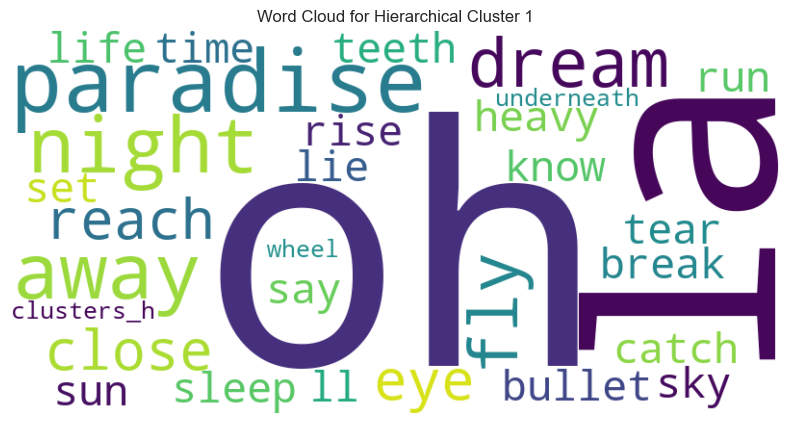

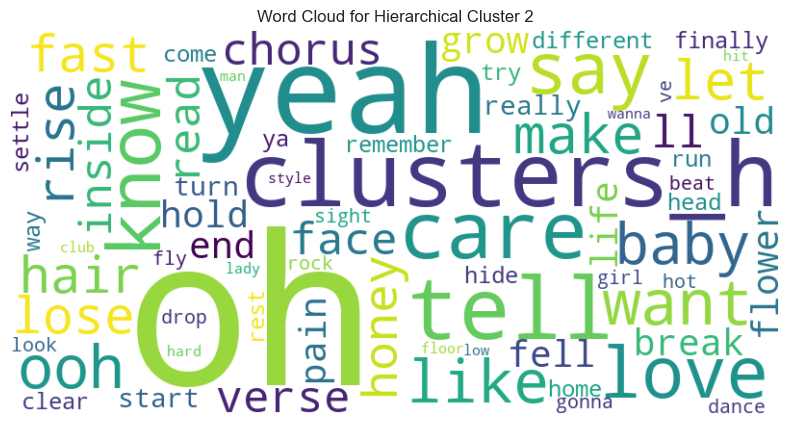

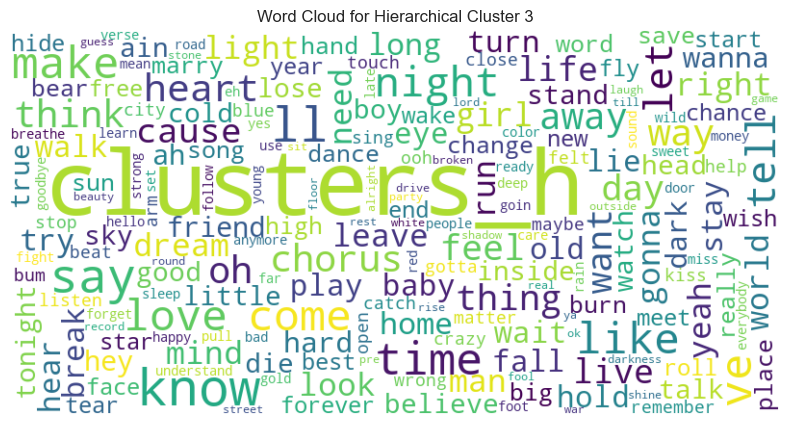

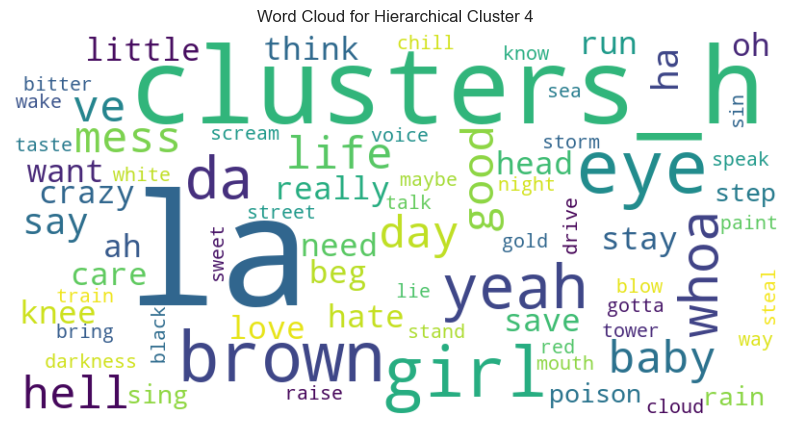

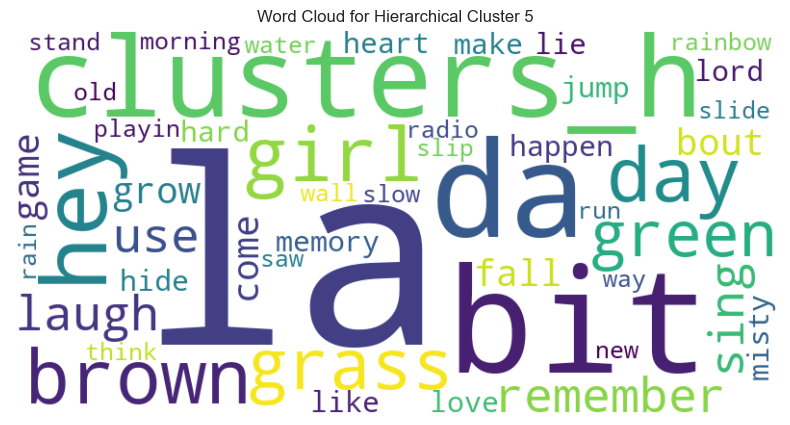

...

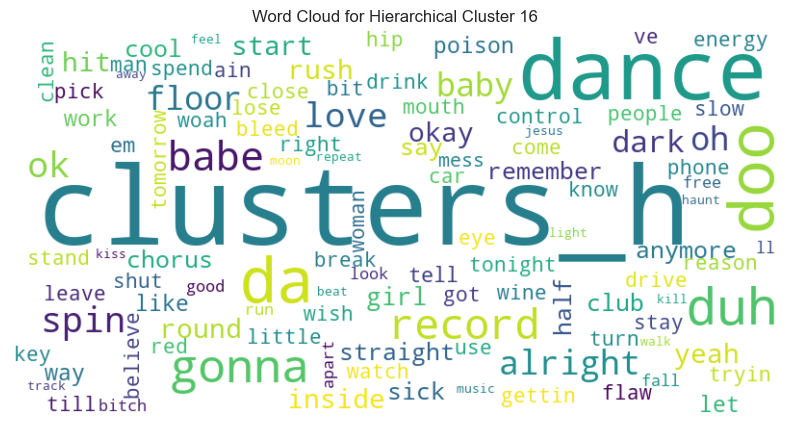

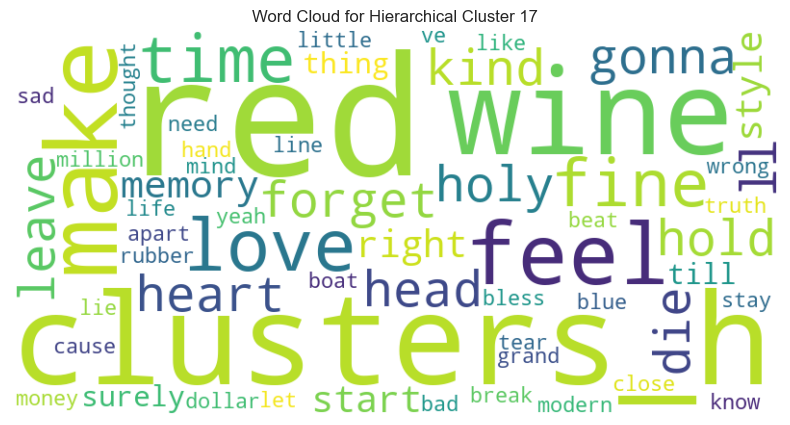

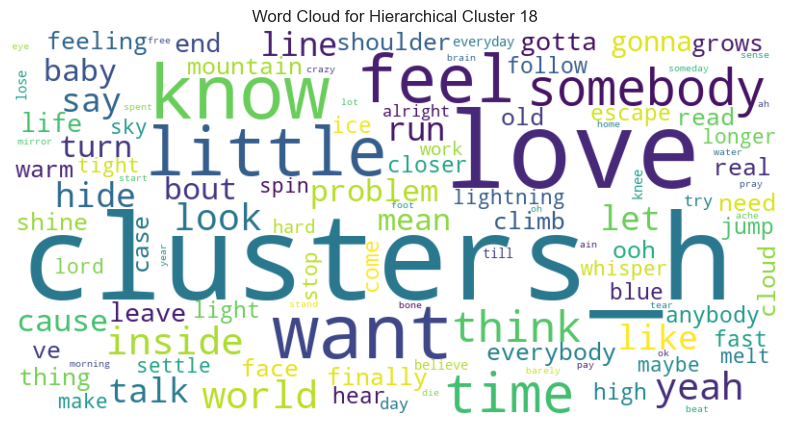

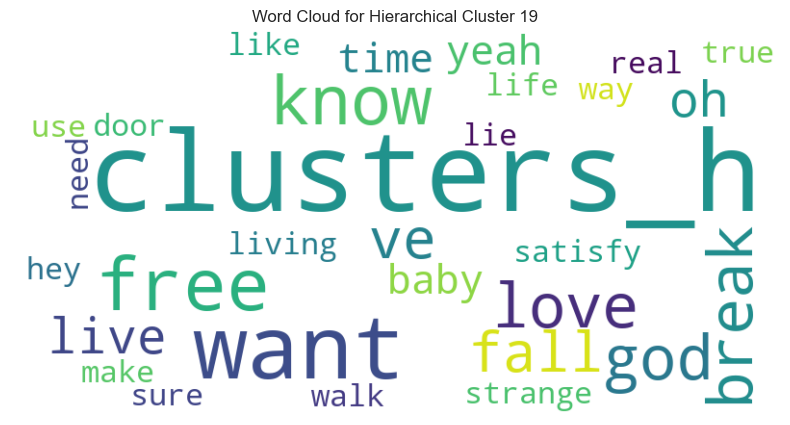

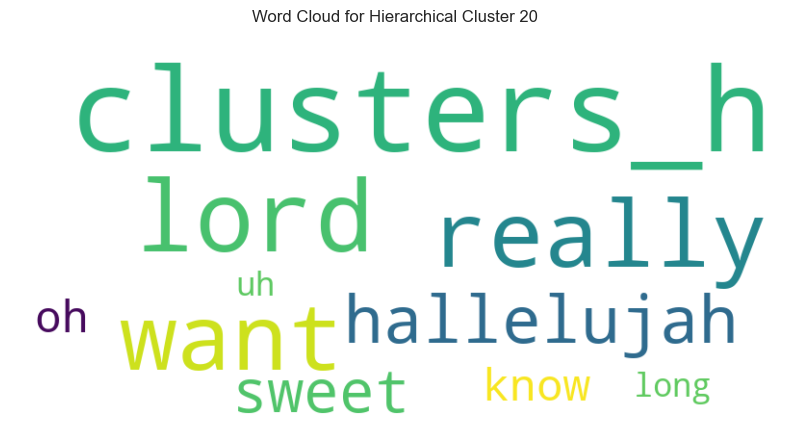

In [366]:
cluster_word_freq = df_bow_h.groupby(df['hierarchical_clusters']).sum()

# For each cluster, generate a word cloud
for cluster in sorted(cluster_word_freq.index):
    plt.figure(figsize=(10, 5))
    
    # Get the word frequencies for this cluster
    word_freq = cluster_word_freq.loc[cluster].to_dict()
    
    # Create and generate a word cloud image
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)
    
    # Display the word cloud
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Hierarchical Cluster {cluster}')
    plt.axis('off')
    plt.show()

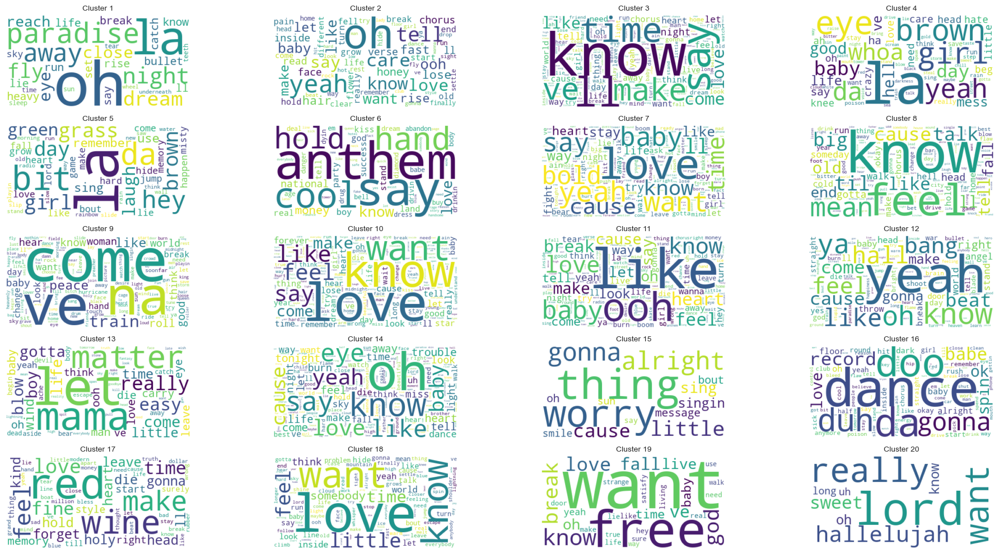

In [367]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assuming 'centroids' is a DataFrame where each row corresponds to a cluster centroid and columns are word frequencies.

# Set up the grid
num_clusters = len(cluster_word_freq)
num_rows = int(np.ceil(np.sqrt(num_clusters)))
num_cols = int(np.ceil(num_clusters / num_rows))

# Create a grid for subplots
plt.figure(figsize=(20, 10))
gs = gridspec.GridSpec(num_rows, num_cols)

# Create a word cloud for each cluster and place it on the grid
for i, cluster in enumerate(centroids.index):
    ax = plt.subplot(gs[i])
    word_freq = centroids.loc[cluster].to_dict()
    wordcloud = WordCloud(width=400, height=200, background_color='white')
    wordcloud.generate_from_frequencies(word_freq)
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.set_title(f'Cluster {cluster}', fontsize=10)
    ax.axis('off')

# Adjust layout
plt.tight_layout()
plt.show()

#### DBSCAN clustering 

In [388]:
from scipy.cluster.hierarchy import linkage, fcluster
from sklearn.cluster import DBSCAN

from sklearn.neighbors import NearestNeighbors
import numpy as np
import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler


In [402]:
# Scale your data, especially important if features have different units
X_scaled = StandardScaler().fit_transform(df_bow)

# Try different values of eps and min_samples
db = DBSCAN(eps=0.9, min_samples=100).fit(X_scaled)  # these are example values

# Check the number of clusters and adjust parameters if necessary
labels = db.labels_


In [403]:
df['dbscan_clusters'] = labels

In [404]:
df['dbscan_clusters'].value_counts

<bound method IndexOpsMixin.value_counts of 0      -1
1      -1
2      -1
3      -1
4      -1
       ..
2668   -1
2669   -1
2670   -1
2671   -1
2672   -1
Name: dbscan_clusters, Length: 2608, dtype: int64>

the result of DBSCAN need to be further revised 

In [452]:
df.to_csv('df_processed.csv', index=False)

## Similarity score  betweeen two songs 

In [368]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial.distance import euclidean


In [407]:
# Preprocess and vectorize lyrics
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(df['cleaned_text'])

- currently, the version is that:
    - you can `randomly input the index of two songs` (section of songs), to see how similar two songs are considering the numerical feature such as tempo, key and valence, etc, as well as chord progression and lyrics similarities. 
    - user can `adjusting the weighting assigned to each element`, to see how the score changes along with different weighting 

- next, i hope to `connect into Sportify API`: 
    - so you can randomly input the song of two songs, to see their similarity score 

- also, i would like to turn it into an recommendation algorithm: 
    - for instance, after input the name of one song, user may adjusting the weighting according to their preference, and it will `matching 5 most similar songs` according to the input song features and weighting assigned for each element using hierarchical clustering from bottom to top.
    - for the `record label`, it can be useful if it wish to sign bands with similar vibe. 
    - for the `musician`, it may feed the inspirations. if you particular like the lyrics of one song, and wish to find more songs with similar lyrics. Or if you particular like the tempo, or chord progression of a song, etc. 
    - for the `common people`, it would also be a fun tool to play with 
    - for the `AI`, it may form a material pool, where it can be used to generated more targeted content. For example, if it may want to generate a post-punk song, it can look over all the lyrics, and other features, to generate a new song. 
    


Another thoughts: 
- make the radar graph compare two seemingly 'similar' bands, or the same bands in different period. 
    - in the aspects, such as topic modelling to see if there is a theme shift. 
    - chord progression, tempo, key to see if there is pattern of creation 
    - also other features such as dancebility, valence, etc to see how holistically evaluate the band 

- This can be useful tool for the fans of band, to write a machine perspective biography. 
- It can also provide valid evidence to see if you want to put same bands in a music festival/same stage to attract customer with this particular taste. 
- Also, for the imitator, it can see as the evidence of copy. which aspect do they 'copy' the most


In [408]:
def calculate_similarity_between_two_songs(input_index_1, input_index_2, weights):
    # Check if the indices are within the range of the DataFrame
    if input_index_1 >= len(df) or input_index_2 >= len(df):
        return "One or both indices are out of range."

    # Extracting features of both songs
    song_1 = df.iloc[input_index_1]
    song_2 = df.iloc[input_index_2]

    # Calculate textual similarity
    lyric_similarity = cosine_similarity(tfidf_matrix[input_index_1], tfidf_matrix[input_index_2])[0][0]

    # Convert chord progressions to strings
    chord_strings = [' '.join(cp.split(',')) for cp in df.cp]

    # Create a CountVectorizer object to transform the chord progressions into vectors
    vectorizer = CountVectorizer()

    # Transform the chord progressions into vectors
    chord_vectors = vectorizer.fit_transform(chord_strings)

    # Calculate cosine similarity matrix
    chord_similarity = cosine_similarity(chord_vectors)

    # Calculate numerical similarity for each feature and aggregate
    numerical_similarity = 0
    for feature in ['danceability', 'energy', 'key', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature']:
        feature_similarity = 1 - (abs(song_1[feature] - song_2[feature]) / max(df[feature].max(), 1))
        numerical_similarity += weights[feature] * feature_similarity

    # Normalize numerical similarity
    total_weight = sum(weights.values())
    numerical_similarity /= total_weight

    # Combine similarities (adjust weights as needed)
    combined_similarity = weights['lyrics'] * lyric_similarity + weights['cp'] * chord_similarity + numerical_similarity
    
    # Print song details
    print(f"Song 1: {song_1['song']}, Key: {song_1['key_labels']}, lyrics: {song_1['text_2'][:100]}...")
    print(f"Song 2: {song_2['song']}, Key: {song_2['key_labels']}, Lyrics: {song_2['text_2'][:100]}...")

    return combined_similarity



Song 1: crazy little thing called love, Key: $D$, lyrics: This thing (this thing)
Called love (called love)
It cries (like a baby)
In a cradle all night
It sw...
Song 2: i want to break free, Key: $E$, Lyrics: I want to break free
I've got to break free...


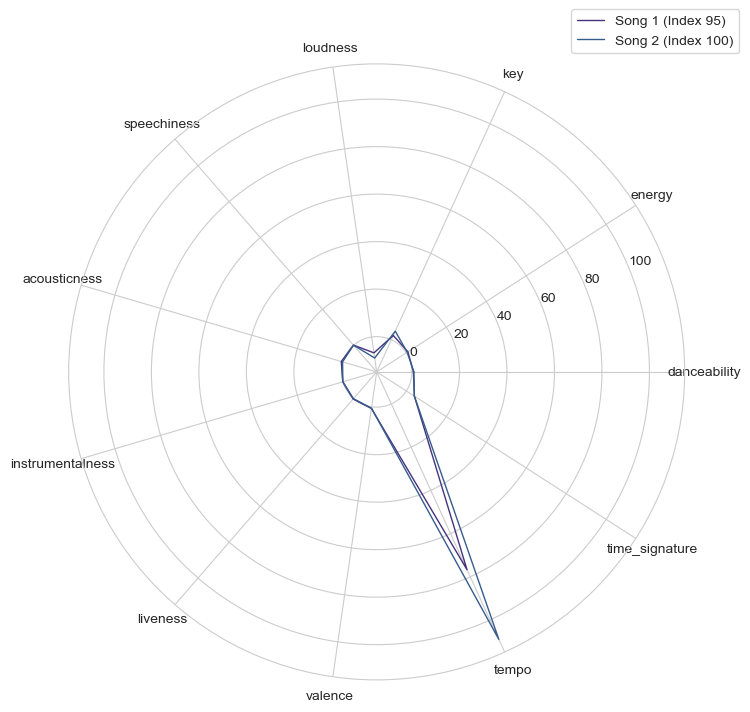

In [453]:
import numpy as np
import matplotlib.pyplot as plt
from math import pi

def plot_radar_chart(input_index_1, input_index_2, df, tfidf_matrix):
    # Calculate similarity scores
    similarity_scores = calculate_similarity_between_two_songs(input_index_1, input_index_2, weights)

    # Features to include in the radar chart
    features = ['danceability', 'energy', 'key', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature']
    
    # Values for each feature for both songs
    values_song_1 = [df.iloc[input_index_1][feature] for feature in features]
    values_song_2 = [df.iloc[input_index_2][feature] for feature in features]

    # Number of variables
    num_vars = len(features)

    # Compute angle for each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]  # Complete the loop

    # Radar chart plot
    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

    # First song
    values_song_1 += values_song_1[:1]
    ax.plot(angles, values_song_1, linewidth=1, linestyle='solid', label=f'Song 1 (Index {input_index_1})')

    # Second song
    values_song_2 += values_song_2[:1]
    ax.plot(angles, values_song_2, linewidth=1, linestyle='solid', label=f'Song 2 (Index {input_index_2})')

    # Feature names
    plt.xticks(angles[:-1], features)

    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.1, 1.1))

    plt.show()

# Call the function with your indices, df, and tfidf_matrix
plot_radar_chart(input_index_1, input_index_2, df, tfidf_matrix)


In [420]:
# Example usage
input_index_1 = 95  # Replace with the index of the first song
input_index_2 = 100  # Replace with the index of the second song

# Weights for each feature
weights = {
    'lyrics': 0.4,  # Adjust this as needed
    'cp': 0.05,
    'danceability': 0.05,
    'energy': 0.05,
    'key': 0.05,
    'loudness': 0.05,
    'mode': 0.05,
    'speechiness': 0.05,
    'acousticness': 0.05,
    'instrumentalness': 0.05,
    'liveness': 0.05,
    'valence': 0.05,
    'tempo': 0.05,
    'time_signature':0.05
}

similarity_score = calculate_similarity_between_two_songs(input_index_1, input_index_2, weights)

print(f"Similarity Score: {similarity_score[1][1]}")

Song 1: crazy little thing called love, Key: $D$, lyrics: This thing (this thing)
Called love (called love)
It cries (like a baby)
In a cradle all night
It sw...
Song 2: i want to break free, Key: $E$, Lyrics: I want to break free
I've got to break free...
Similarity Score: 0.33353104992420546


In [421]:
calculate_similarity_between_two_songs(input_index_1, input_index_2, weights)[1][1]

Song 1: crazy little thing called love, Key: $D$, lyrics: This thing (this thing)
Called love (called love)
It cries (like a baby)
In a cradle all night
It sw...
Song 2: i want to break free, Key: $E$, Lyrics: I want to break free
I've got to break free...


0.33353104992420546

## Sentimental analysis

## Feature Engineering - Rule-based Word Processing
So far, we have removed duplicated rows, extract important information such as hashtags, mentioned users and users' locations, and also cleaned up the tweets in the previous section. In the coming section, we will focus on Rule-based word processing for our sentiment analysis. We will postpone some exploratory data visualization till later once we have all the ingredients.

### Generating Sentiments from Tweets with NLTK Vader_Lexicon Library
We will be using the Vader_lexicon library from NLTK to generate sentiment for each review. Vader uses lexicon of words to determine which words in the reviews are positive or negative. It will return a set of 4 scores on the positivity, negativity, neutrality of a text, and also an overall score whether a text is positive or negative.
1. Positivity - 'pos'
2. Negativity - 'neg'
3. Neutrality - 'neu'
4. Overall Score - 'compound'

In [195]:
# Importing VADER from NLTK
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Create a sid object called SentimentIntensityAnalyzer()
sid = SentimentIntensityAnalyzer()

import re
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.tag import pos_tag
from nltk.stem.wordnet import WordNetLemmatizer
import string
from nltk.corpus import wordnet
from nltk.tokenize import WhitespaceTokenizer
from nltk.stem import WordNetLemmatizer

In [438]:
# Apply polarity_score method of SentimentIntensityAnalyzer()
df['sentiment'] = df['cleaned_text'].apply(lambda x: sid.polarity_scores(x))

# Keep only the compound scores under the column 'Sentiment'
df = pd.concat([df.drop(['sentiment'], axis = 1), df['sentiment'].apply(pd.Series)], axis = 1)

df.head(2)

,cp,artist,song,section,spotify_ID,danceability,energy,key,loudness,mode,...,clusters,cleaned_text,knn_clusters,hierarchical_clusters,dbscan_clusters,sentiment_class,neg,neu,pos,compound
0,"1,5,6",aerosmith,cryin',verse,0NJC0FDCODpPUntRTTQq97,0.445,0.856,9.0,-3.674,1.0,...,6,time brokenhearted love much friend mine table turn yeah cause way part kinda love killin kind want someone can't resist know need know way get kiss i'm dryin cause let there's even breathe room pleasure pain yeah cry we're makin love must one yeah get tell one thing mind girl gotta say we're partner crime get certain something take breath away word street devil's kiss love go flames that's fire can't resist cause get inside ain't love stay yeah love sweet love ain't love til give heart away i'm dyin let baby baby baby,6,7,-1,10,0.084,0.477,0.439,0.9943
1,"4,1,4,1",aerosmith,cryin',pre-chorus,0NJC0FDCODpPUntRTTQq97,0.445,0.856,9.0,-3.674,1.0,...,8,cryin meet i'm tryin forget love sweet misery cryin get i'm dyin cause let,8,3,-1,7,0.246,0.439,0.316,0.3818


In [439]:
# Focus on 'compound' scores
# Create a new column called 'sentiment_class'
sentimentclass_list = []

for i in range(0, len(data)):
    
    # current 'compound' score:
    curr_compound = data.iloc[i,:]['compound']
    
    # Modify these ranges and labels to create 10 classes
    if curr_compound > 0.8:
        sentimentclass_list.append(10)
    elif curr_compound > 0.6:
        sentimentclass_list.append(9)
    elif curr_compound > 0.4:
        sentimentclass_list.append(8)
    elif curr_compound > 0.2:
        sentimentclass_list.append(7)
    elif curr_compound > 0:
        sentimentclass_list.append(6)
    elif curr_compound > -0.2:
        sentimentclass_list.append(5)
    elif curr_compound > -0.4:
        sentimentclass_list.append(4)
    elif curr_compound > -0.6:
        sentimentclass_list.append(3)
    elif curr_compound > -0.8:
        sentimentclass_list.append(2)
    else:  # This covers the range -1.0 to -0.8
        sentimentclass_list.append(1)

# Add the new column 'sentiment_class' to the dataframe
df['sentiment_class'] = sentimentclass_list

# Check out the new column
df.tail()['sentiment_class']


2668    10
2669     6
2670     5
2671     2
2672     6
Name: sentiment_class, dtype: int64

In [440]:
# Verify if the classification assignment is correct:
df.iloc[0:5, :][['compound', 'sentiment_class']]

,compound,sentiment_class
0,0.9943,10
1,0.3818,7
2,0.9943,10
3,0.9943,10
4,0.2500,7


In [441]:
# Fill NaN values in 'sentiment_class' with 0
df['sentiment_class'].fillna(0, inplace=True)

# Display the frequency of each unique value in the 'sentiment_class' column
print(data['sentiment_class'].value_counts())

sentiment_class
10    882
9     356
5     320
8     229
1     214
7     184
4     138
2     121
3      98
6      66
Name: count, dtype: int64


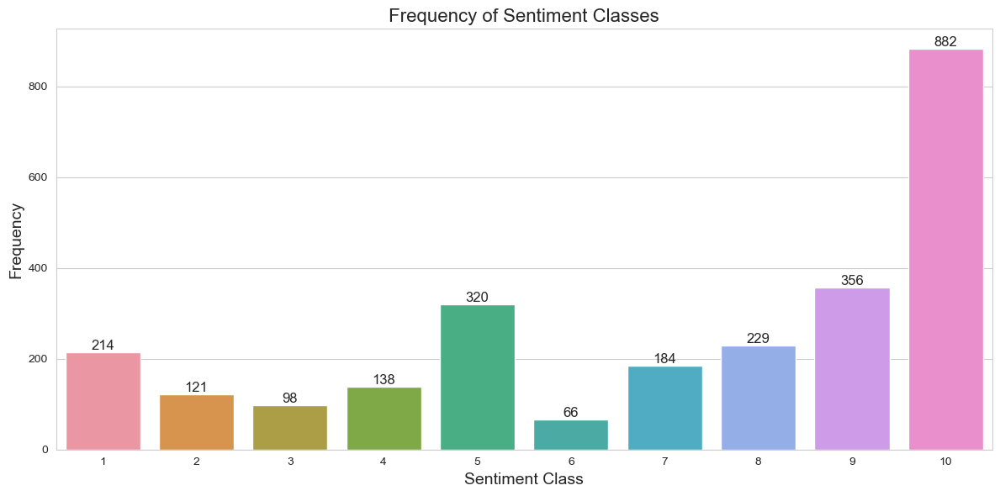

In [443]:
import matplotlib.pyplot as plt
import seaborn as sns

# Frequency of sentiment_class
frequency = data['sentiment_class'].value_counts().sort_index()

# Set a color palette
sns.set_palette("viridis")

# Set the style
sns.set_style("whitegrid")

# Create the plot
plt.figure(figsize=(12, 6))

# Create a bar plot
sns.barplot(x=frequency.index, y=frequency.values)

# Add title and labels with font size adjustments
plt.title('Frequency of Sentiment Classes', fontsize=16)
plt.xlabel('Sentiment Class', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

# Adding the value labels on top of each bar
for index, value in enumerate(frequency.values):
    plt.text(index, value, f'{value}', ha='center', va='bottom', fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()


## LDA 

In [429]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation


#### LDA without label preset

- no specific pattern

In [433]:
# Choose the number of topics you want to discover
num_topics = 20

lda = LatentDirichletAllocation(n_components=num_topics, random_state=42)
lda.fit(bow_matrix)

# To display topics and their top words
feature_names = vectorizer.get_feature_names_out()
for topic_idx, topic in enumerate(lda.components_):
    print("Topic #%d:" % topic_idx)
    print(" ".join([feature_names[i] for i in topic.argsort()[:-10 - 1:-1]]))

Topic #0:
bop conclusion adventure blush albert ale boardwalk baby anybody caribbean
Topic #1:
caribbean billie bottom clap battle arise blueprint baggies chair canvas
Topic #2:
blitzen bridge boac army bop class best bomb armageddon birth
Topic #3:
bosom camera caribbean bop comfortably blitzen coma clap adventure boardwalk
Topic #4:
brim afraid baby captain alien arise awake bond boardwalk cavitate
Topic #5:
blitzen class beating compromise compressor captain civilization boardwalk amen best
Topic #6:
brim blond bristle admit battle coaster adventure bruise bridge baby
Topic #7:
cake bosom angle brim comparison baggies bop accidentally blitzen anymore
Topic #8:
blitzen boardwalk bop claude amen charlie angle alright blueprint communication
Topic #9:
boundary boardwalk bolt blitzen cliff beige ah amen baggies bold
Topic #10:
coma bolt bop blitzen coldly boardwalk caesura bosom baggies caribbean
Topic #11:
blitzen bop baggies coma battle bolt boardwalk clearing bosom bond
Topic #12:
co

#### LDA with the label preset as the sentimental class 

In [445]:
from collections import defaultdict

# Assuming 'data' is a DataFrame with a 'lyrics' column and a 'genre' column
genre_topics = defaultdict(list)

for genre in df['sentiment_class'].unique():
    genre_lyrics = data[df['sentiment_class'] == genre]['cleaned_text']

    vectorizer = CountVectorizer(stop_words='english')
    X = vectorizer.fit_transform(genre_lyrics)
    
    lda = LatentDirichletAllocation(n_components=num_topics, random_state=0)
    lda.fit(X)
    
    feature_names = vectorizer.get_feature_names_out()
    for topic_idx, topic in enumerate(lda.components_):
        genre_topics[genre].append(" ".join([feature_names[i] for i in topic.argsort()[:-10 - 1:-1]]))

for genre, topics in genre_topics.items():
    print(f"Genre: {genre}")
    for idx, topic in enumerate(topics):
        print(f"Topic #{idx}: {topic}")


Genre: 10
Topic #0: say like anthem know hold cool hand tell love money
Topic #1: dance la da gonna doo party oh floor drink babe
Topic #2: ooh yeah like baby know true color ya ll girl
Topic #3: love know heart say time leave thing gonna ve feel
Topic #4: like make love really want lord baby cause long think
Topic #5: want hey know free love break god ve fall oh
Topic #6: love hallelujah beautiful oh know heart tonight really ve ride
Topic #7: oh yeah know love tell care like baby want stop
Topic #8: red love wine make like feel know start time night
Topic #9: baby ll wake live play ice save let song inside
Topic #10: love turn know mama applause radio man way live tell
Topic #11: yeah world talk cold whore away desire burn somebody love
Topic #12: love honey dream like come ya child religion change wind
Topic #13: love know annie ok little run think time come ve
Topic #14: love want yeah feel like know baby come time stay
Topic #15: love bold girl yeah know like say ask life smile
To

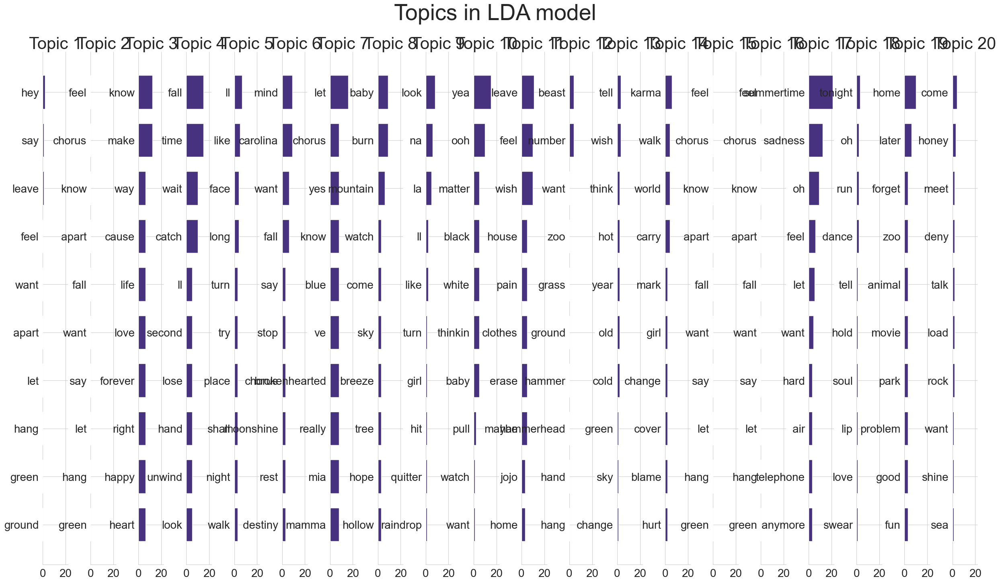

In [446]:
import matplotlib.pyplot as plt

def plot_top_words(model, feature_names, n_top_words, title):
    fig, axes = plt.subplots(1, model.n_components, figsize=(30, 15), sharex=True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[:-n_top_words - 1:-1]
        top_features = [feature_names[i] for i in top_features_ind]
        weights = topic[top_features_ind]

        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f'Topic {topic_idx +1}', fontdict={'fontsize': 30})
        ax.invert_yaxis()
        ax.tick_params(axis='both', which='major', labelsize=20)
        for i in 'top right left'.split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=40)

    plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
    plt.show()

# Assuming you have a fitted LDA model and a feature_names list
plot_top_words(lda, feature_names, 10, 'Topics in LDA model')

# For genre-based LDA, call this function inside the loop where you fit LDA for each genre
# And change the title accordingly, e.g., f'Topics in LDA model for {genre} genre'


Sentiment Class: 10


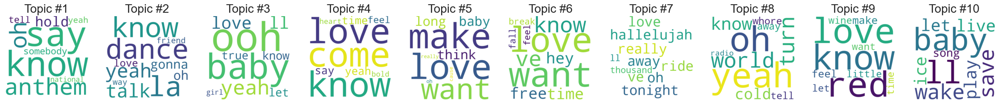

Sentiment Class: 7


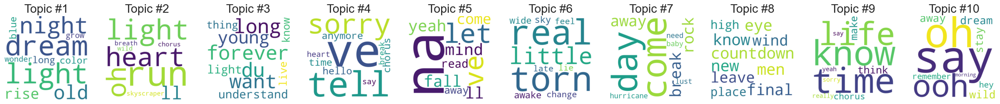

Sentiment Class: 3


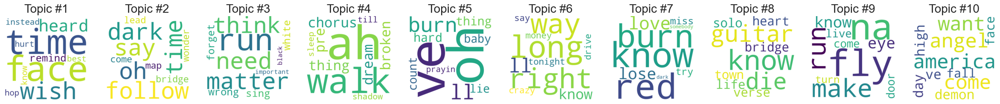

Sentiment Class: 9


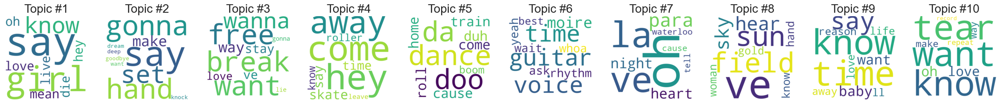

Sentiment Class: 8


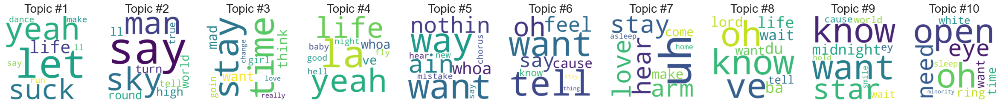

Sentiment Class: 5


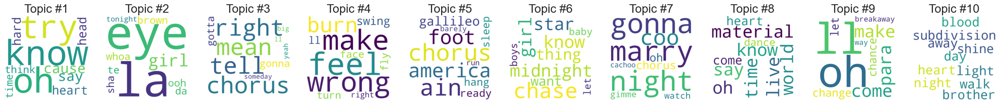

Sentiment Class: 1


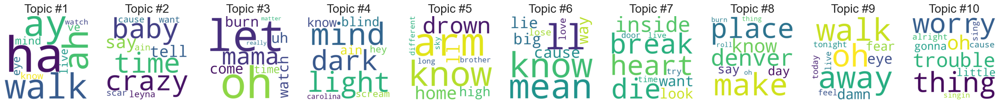

Sentiment Class: 2


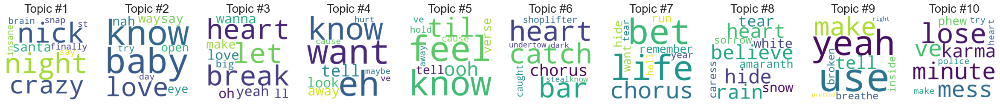

Sentiment Class: 4


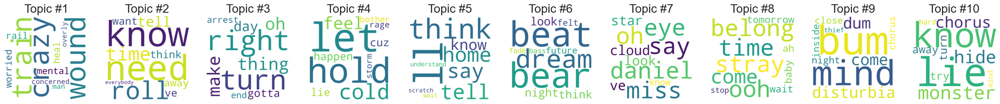

Sentiment Class: 6


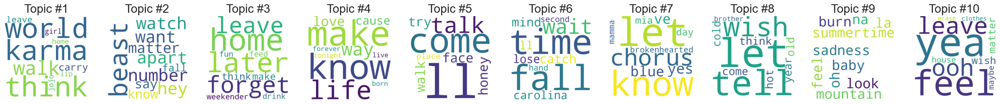

In [449]:
from collections import defaultdict
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame with a 'cleaned_text' column and a 'sentiment_class' column
num_topics = 10  # Define the number of topics

genre_topics = defaultdict(list)

for genre in df['sentiment_class'].unique():
    genre_lyrics = df[df['sentiment_class'] == genre]['cleaned_text']

    vectorizer = CountVectorizer(stop_words='english')
    X = vectorizer.fit_transform(genre_lyrics)

    lda = LatentDirichletAllocation(n_components=num_topics, random_state=0)
    lda.fit(X)

    feature_names = vectorizer.get_feature_names_out()
    for topic_idx, topic in enumerate(lda.components_):
        genre_topics[genre].append(" ".join([feature_names[i] for i in topic.argsort()[:-10 - 1:-1]]))

# Function to plot word clouds for each topic in each sentiment class
def plot_word_clouds(genre_topics):
    for genre, topics in genre_topics.items():
        print(f"Sentiment Class: {genre}")

        # Create a subplot for each topic
        fig, axes = plt.subplots(1, len(topics), figsize=(30, 10))

        if len(topics) == 1:  # If there's only one topic, axes will not be an array
            axes = [axes]

        for idx, topic_words in enumerate(topics):
            wordcloud = WordCloud(width=400, height=400, background_color='white').generate(topic_words)

            axes[idx].imshow(wordcloud, interpolation='bilinear')
            axes[idx].set_title(f'Topic #{idx + 1}', fontsize=20)
            axes[idx].axis("off")

        plt.show()

# Generate word clouds
plot_word_clouds(genre_topics)
